In [1]:
import warnings
# import opendatasets as od
import os

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import seaborn as sns

from statsmodels.tsa.stattools import grangercausalitytests, adfuller, ccf
from statsmodels.tsa.seasonal import MSTL
from statsmodels.tsa.api import VAR
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from scipy.stats import spearmanr

from sklearn.pipeline import make_pipeline
from feature_engine.encoding import OrdinalEncoder
from feature_engine.creation import CyclicalFeatures
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error

from xgboost import XGBRegressor
from tqdm.auto import tqdm

sns.set(style="ticks", palette="muted", color_codes=True)

warnings.filterwarnings("ignore")

plt.rcParams['axes.labelsize'] = 15
plt.rcParams['axes.titlesize'] = 20

seed = 42

In [2]:
# od.download("https://www.kaggle.com/competitions/store-sales-time-series-forecasting/data")

In [3]:
folder = "store-sales-time-series-forecasting"

datasets = [
    folder + "/" + f for f in os.listdir('store-sales-time-series-forecasting') if f.endswith(".csv")
]

In [4]:
datasets

['store-sales-time-series-forecasting/holidays_events.csv',
 'store-sales-time-series-forecasting/oil.csv',
 'store-sales-time-series-forecasting/sample_submission.csv',
 'store-sales-time-series-forecasting/stores.csv',
 'store-sales-time-series-forecasting/test.csv',
 'store-sales-time-series-forecasting/train.csv',
 'store-sales-time-series-forecasting/transactions.csv']

#### holidays_events

In [5]:
holiday_df = pd.read_csv(datasets[0], parse_dates=["date"])

In [6]:
for col in holiday_df.columns[1:]:
    print(col)
    print("*" * len(col))
    print(holiday_df[col].value_counts())
    print()

type
****
Holiday       222
Event          56
Additional     52
Transfer       12
Bridge          5
Work Day        5
Name: type, dtype: int64

locale
******
National    176
Local       152
Regional     24
Name: locale, dtype: int64

locale_name
***********
Ecuador                           176
Quito                              13
Riobamba                           12
Guaranda                           12
Latacunga                          12
Ambato                             12
Guayaquil                          11
Cuenca                              7
Ibarra                              7
Salinas                             6
Loja                                6
Santa Elena                         6
Santo Domingo de los Tsachilas      6
Quevedo                             6
Manta                               6
Esmeraldas                          6
Cotopaxi                            6
El Carmen                           6
Santo Domingo                       6
Machala             

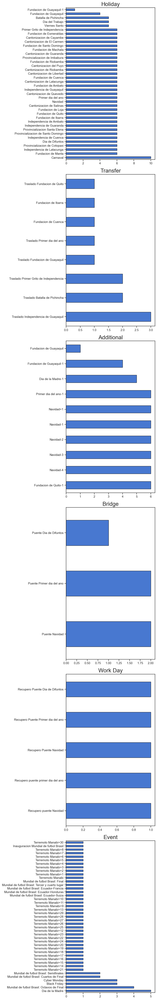

In [7]:
fig, axes = plt.subplots(6, 1, figsize=(8, 50), tight_layout=True)

for name, ax in zip(holiday_df["type"].unique(), axes.flatten()):

    holiday_df.loc[holiday_df["type"].eq(name), "description"].value_counts().\
        plot(kind="barh", ax=ax, edgecolor="k")

    ax.set_title(name)

"Holidays" are official holidays that repeats every year. Additional holidays usually occurs before and/or after the official holidays. A holiday that is transferred officially falls on that calendar day, but was moved to another date by the government. 

Events are not exactly holidays special events that probably affect the sales. The main events here are Football, earthquake in manabi, Monthers day, black friday and cyber monday. 

In [8]:
holiday_df.query("description == 'Cyber Monday'")

,date,type,locale,locale_name,description,transferred
145,2014-12-01,Event,National,Ecuador,Cyber Monday,False
199,2015-11-30,Event,National,Ecuador,Cyber Monday,False
285,2016-11-28,Event,National,Ecuador,Cyber Monday,False


In [9]:
holiday_df.query("description == 'Black Friday'")

,date,type,locale,locale_name,description,transferred
144,2014-11-28,Event,National,Ecuador,Black Friday,False
198,2015-11-27,Event,National,Ecuador,Black Friday,False
284,2016-11-25,Event,National,Ecuador,Black Friday,False


In [10]:
holiday_df.query("description.str.contains(r'Madre')", engine="python")

# holiday_df.loc[holiday_df['description'].str.contains(r'Madre')]

,date,type,locale,locale_name,description,transferred
53,2013-05-11,Additional,National,Ecuador,Dia de la Madre-1,False
55,2013-05-12,Event,National,Ecuador,Dia de la Madre,False
102,2014-05-10,Additional,National,Ecuador,Dia de la Madre-1,False
103,2014-05-11,Event,National,Ecuador,Dia de la Madre,False
171,2015-05-09,Additional,National,Ecuador,Dia de la Madre-1,False
172,2015-05-10,Event,National,Ecuador,Dia de la Madre,False
242,2016-05-07,Additional,National,Ecuador,Dia de la Madre-1,False
245,2016-05-08,Event,National,Ecuador,Dia de la Madre,False
310,2017-05-13,Additional,National,Ecuador,Dia de la Madre-1,False
311,2017-05-14,Event,National,Ecuador,Dia de la Madre,False


### oil

In [11]:
oil_df = pd.read_csv(datasets[1], parse_dates=["date"], index_col="date")

In [12]:
oil_df.info()  # some missing values exists

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1218 entries, 2013-01-01 to 2017-08-31
Data columns (total 1 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   dcoilwtico  1175 non-null   float64
dtypes: float64(1)
memory usage: 19.0 KB


In [13]:
oil_df.isna().sum()  # 43 missing values

dcoilwtico    43
dtype: int64

In [14]:
oil_df.index.freq = "B"  # setting data frequency to business days

In [15]:
oil_df.index

DatetimeIndex(['2013-01-01', '2013-01-02', '2013-01-03', '2013-01-04',
               '2013-01-07', '2013-01-08', '2013-01-09', '2013-01-10',
               '2013-01-11', '2013-01-14',
               ...
               '2017-08-18', '2017-08-21', '2017-08-22', '2017-08-23',
               '2017-08-24', '2017-08-25', '2017-08-28', '2017-08-29',
               '2017-08-30', '2017-08-31'],
              dtype='datetime64[ns]', name='date', length=1218, freq='B')

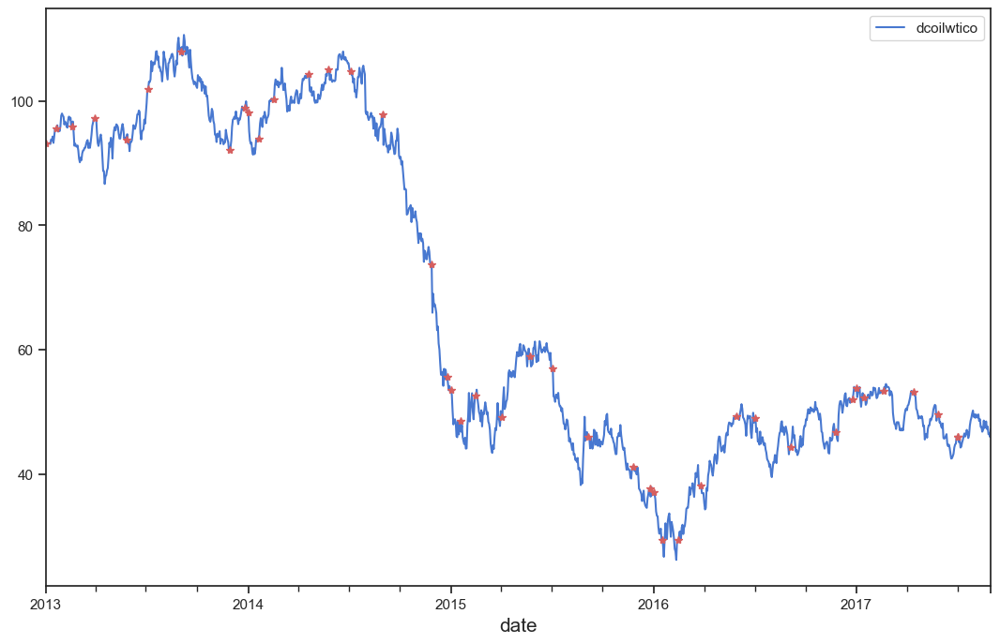

In [16]:
oil_df_imputed = oil_df.fillna(method="ffill").fillna(method="bfill")

ax = oil_df_imputed.plot(figsize=(13, 8), linestyle="-")

oil_df_imputed[oil_df.isnull()].plot(ax=ax,
                                     legend=None,
                                     marker="*",
                                     color="r",
                                     linestyle="-");

### stores

In [17]:
store_df = pd.read_csv(datasets[3])
store_df

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4
5,6,Quito,Pichincha,D,13
6,7,Quito,Pichincha,D,8
7,8,Quito,Pichincha,D,8
8,9,Quito,Pichincha,B,6
9,10,Quito,Pichincha,C,15


In [18]:
for col in store_df.columns[1:]:
    print(col)
    print("*" * len(col))
    print(store_df[col].value_counts())
    print()

city
****
Quito            18
Guayaquil         8
Cuenca            3
Santo Domingo     3
Manta             2
Latacunga         2
Machala           2
Ambato            2
Quevedo           1
Esmeraldas        1
Loja              1
Libertad          1
Playas            1
Daule             1
Babahoyo          1
Salinas           1
Puyo              1
Guaranda          1
Ibarra            1
Riobamba          1
Cayambe           1
El Carmen         1
Name: city, dtype: int64

state
*****
Pichincha                         19
Guayas                            11
Santo Domingo de los Tsachilas     3
Azuay                              3
Manabi                             3
Cotopaxi                           2
Tungurahua                         2
Los Rios                           2
El Oro                             2
Chimborazo                         1
Imbabura                           1
Bolivar                            1
Pastaza                            1
Santa Elena                    

Most of the stores are located in Quito, the capital of Ecuador

In [19]:
np.sort(store_df["store_nbr"].unique())

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54], dtype=int64)

### Train

In [20]:
train_df = pd.read_csv(datasets[5], parse_dates=["date"]).drop("id", axis=1)

In [21]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000888 entries, 0 to 3000887
Data columns (total 5 columns):
 #   Column       Dtype         
---  ------       -----         
 0   date         datetime64[ns]
 1   store_nbr    int64         
 2   family       object        
 3   sales        float64       
 4   onpromotion  int64         
dtypes: datetime64[ns](1), float64(1), int64(2), object(1)
memory usage: 114.5+ MB


In [22]:
train_df.isnull().sum()  # No null values

date           0
store_nbr      0
family         0
sales          0
onpromotion    0
dtype: int64

In [23]:
print(train_df["family"].unique())
print(len(train_df["family"].unique()))

# 33 products for each store

['AUTOMOTIVE' 'BABY CARE' 'BEAUTY' 'BEVERAGES' 'BOOKS' 'BREAD/BAKERY'
 'CELEBRATION' 'CLEANING' 'DAIRY' 'DELI' 'EGGS' 'FROZEN FOODS' 'GROCERY I'
 'GROCERY II' 'HARDWARE' 'HOME AND KITCHEN I' 'HOME AND KITCHEN II'
 'HOME APPLIANCES' 'HOME CARE' 'LADIESWEAR' 'LAWN AND GARDEN' 'LINGERIE'
 'LIQUOR,WINE,BEER' 'MAGAZINES' 'MEATS' 'PERSONAL CARE' 'PET SUPPLIES'
 'PLAYERS AND ELECTRONICS' 'POULTRY' 'PREPARED FOODS' 'PRODUCE'
 'SCHOOL AND OFFICE SUPPLIES' 'SEAFOOD']
33


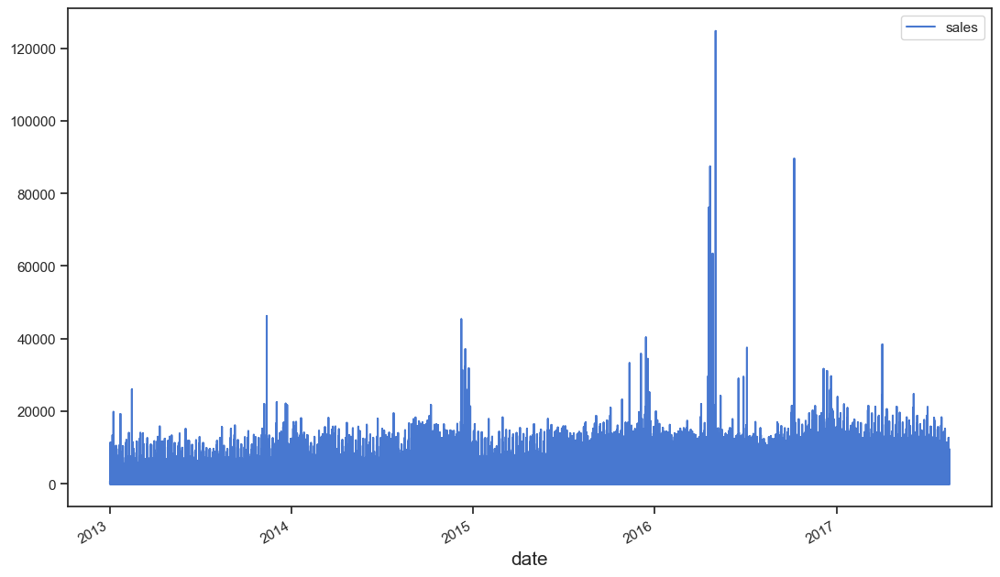

In [24]:
train_df.set_index("date").plot(y="sales", figsize=(13, 8));

In [25]:
train_df.query("date.dt.month==12 and date.dt.month==25")

,date,store_nbr,family,sales,onpromotion


There are no data on christmas days. Therefore I will resample the date column to ensure the data is of daily frequency.

In [26]:
train_df = \
train_df.set_index('date').groupby(['store_nbr', 'family']).resample('D')[['sales', 'onpromotion']].sum().\
    reset_index().sort_values(['date', 'store_nbr', 'family'], ignore_index=True)

In [27]:
# Extracting extra freatures from date columns

train_df["day"] = train_df["date"].dt.day
train_df["month"] = train_df["date"].dt.month
train_df["year"] = train_df["date"].dt.year
train_df["day_of_week"] = train_df["date"].dt.dayofweek
train_df["is_weekend"] = train_df["date"].dt.dayofweek > 4

train_df.head()

,store_nbr,family,date,sales,onpromotion,day,month,year,day_of_week,is_weekend
0,1,AUTOMOTIVE,2013-01-01,0.0,0,1,1,2013,1,False
1,1,BABY CARE,2013-01-01,0.0,0,1,1,2013,1,False
2,1,BEAUTY,2013-01-01,0.0,0,1,1,2013,1,False
3,1,BEVERAGES,2013-01-01,0.0,0,1,1,2013,1,False
4,1,BOOKS,2013-01-01,0.0,0,1,1,2013,1,False


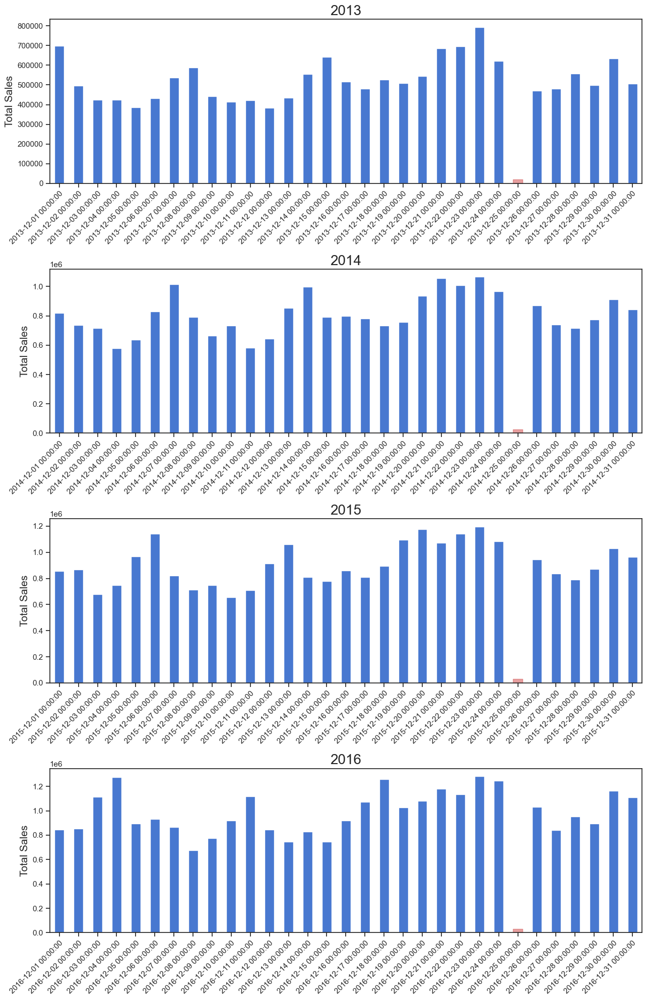

In [28]:
fig, axes = plt.subplots(4, 1, figsize=(13, 20), tight_layout=True)

for year, ax in zip([2013, 2014, 2015, 2016], axes.flatten()):
    
    temp_df = train_df.query(f"year=={year} and month==12").groupby('date')['sales'].sum()
    
    temp_df.plot(kind="bar", ax=ax)
    
    labels=ax.get_xmajorticklabels()
    
    ax.set_xticklabels(labels=labels, ha='right', rotation = 45, rotation_mode='anchor');
    
    ax.fill_between(x=(23.75, 24.25), y1=temp_df.max()*0.025, color="r", alpha=0.6)
    
    ax.set_title(year)
    
    ax.set_xlabel("")
    ax.set_ylabel("Total Sales");

# **There are *no observations* during Christmas (25 Dec) for any of the years!**
#### Probably most businesses are closed on Christmas. So we can assume that there are 0 sales on this day.

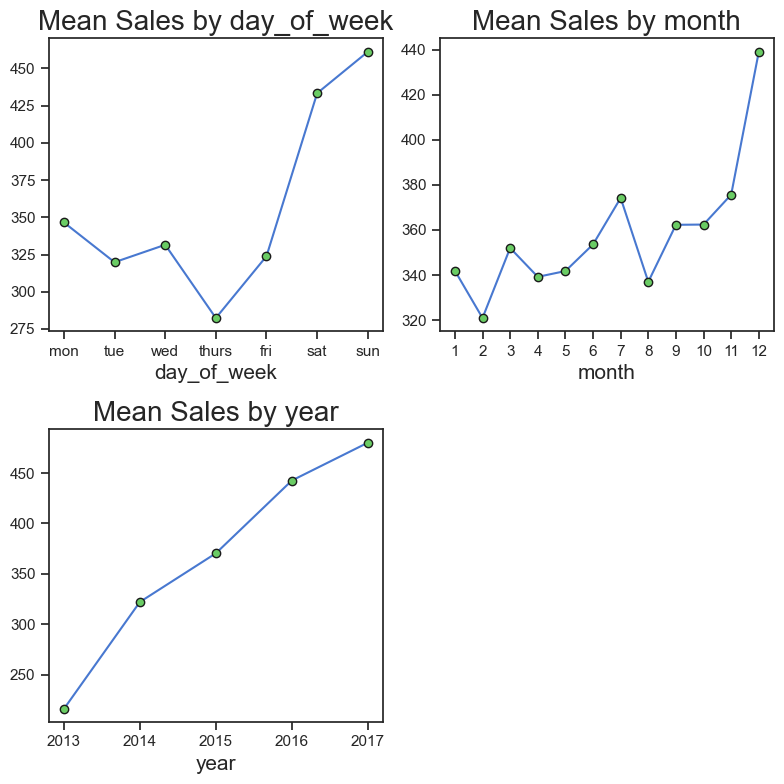

In [29]:
days=["mon", "tue", "wed", "thurs", "fri", "sat", "sun"]

fig, axes = plt.subplots(2, 2, tight_layout=True, figsize=(8, 8))

for col, ax in zip(["day_of_week", "month", "year"], axes.flatten()):

    train_df.groupby(col)["sales"].mean().plot(
        ax=ax, marker="o", mfc="g", mec="k")
    ax.set_title(f"Mean Sales by {col}")

    if col in ["year", "month"]:
        ax.set_xticks(train_df.groupby(col)["sales"].mean().index)
    else:
        ax.set_xticks(train_df.groupby(col)["sales"].mean().index, days)

    if col == "day":
        ax.axvline(15, linestyle="--", color="k")
        
axes.flatten()[-1].set_axis_off()

* *Monthly Seasonality*: In a year, Sales are very high during December and the falls rapidly down on January.

* *Yearly Seasonality*: There is an increase in mean sales every year.

* *Weekly Seasonality*: In a week, Sales are very high during the weekends and lowest on thursday.

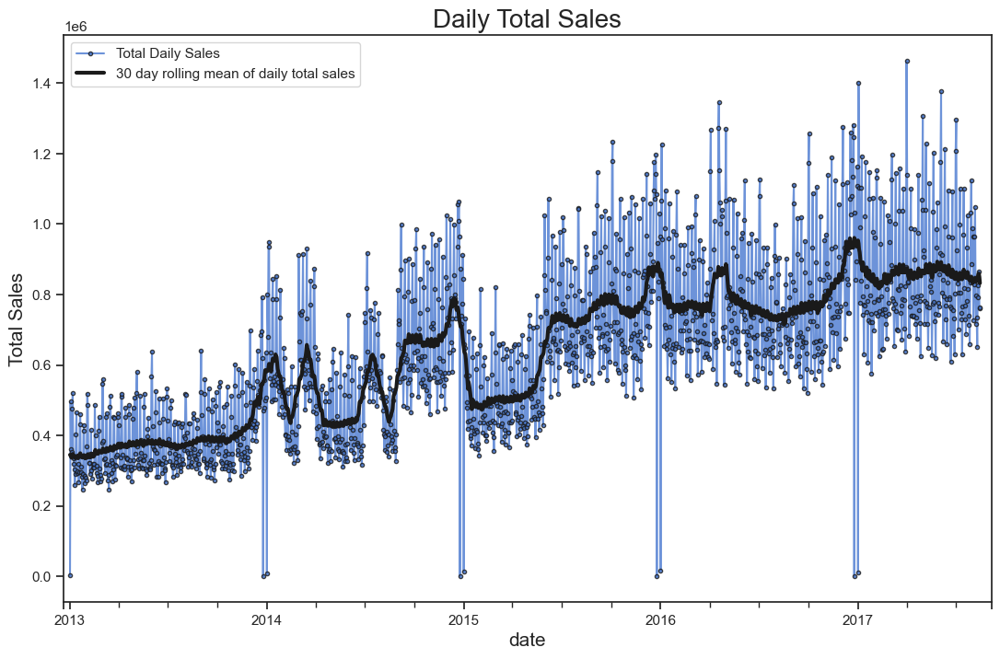

In [30]:
total_daily_sales = train_df.groupby("date")["sales"].sum()

ax = total_daily_sales.plot(y="sales",
                            figsize=(13, 8),
                            marker=".",
                            alpha=0.8,
                            mec='k',
                            legend=None)

total_daily_sales.rolling(window=30, min_periods=7, center=True).mean().\
    plot(ax=ax, lw=3, color="k", legend=None)

plt.legend(
    labels=["Total Daily Sales", "30 day rolling mean of daily total sales"])

plt.title("Daily Total Sales")
plt.ylabel("Total Sales")
plt.xlim("2012-12-20", "2017-09-05");

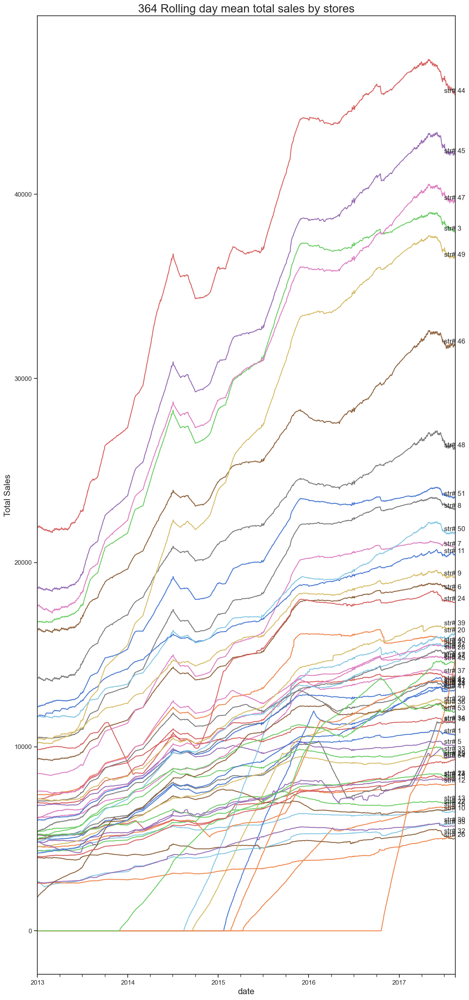

In [31]:
store_total_dly_sales = \
    train_df.groupby(["store_nbr", "date"], as_index=False)["sales"].sum()

fig, ax = plt.subplots(figsize=(13, 30))
roll_period = 364

for store in store_total_dly_sales["store_nbr"].unique():

    roll_mean = \
        store_total_dly_sales.query(f"store_nbr == {store}").set_index("date").\
        rolling(roll_period, center=True, min_periods=30)["sales"].mean().to_frame(f"{store}")

    roll_mean.plot(ax=ax, legend=None)

    xy_coord = roll_mean.reset_index().iloc[-1, :].values

    ax.annotate(text=f"str# {store}",
                xy=xy_coord,
                xytext=xy_coord + np.array([-pd.Timedelta("45 days"), 100]))

plt.ylabel("Total Sales")
plt.title("364 Rolling day mean total sales by stores");

From the above plot, it is clear that sales across stores differs a lot. Some stores perform very well.

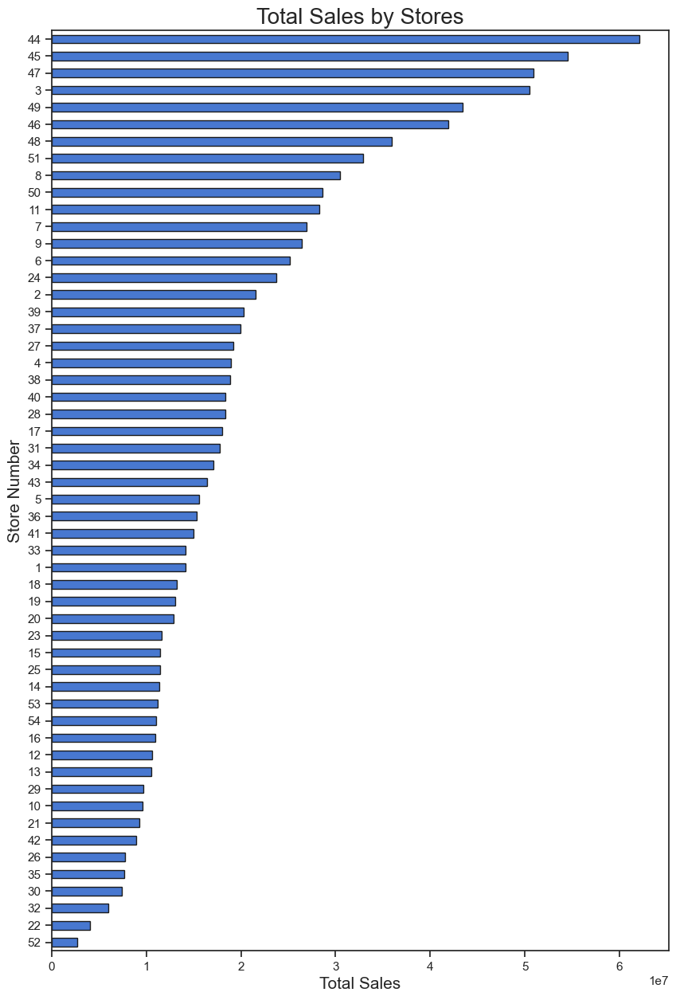

In [32]:
fig, ax = plt.subplots(figsize=(10, 15))

train_df.groupby("store_nbr")["sales"].sum().sort_values().\
    plot(kind="barh", ax=ax, edgecolor="k", title="Total Sales by Stores")

ax.set_xlabel("Total Sales")
ax.set_ylabel("Store Number");

In [33]:
train_df = train_df.merge(store_df, on="store_nbr", how="left")

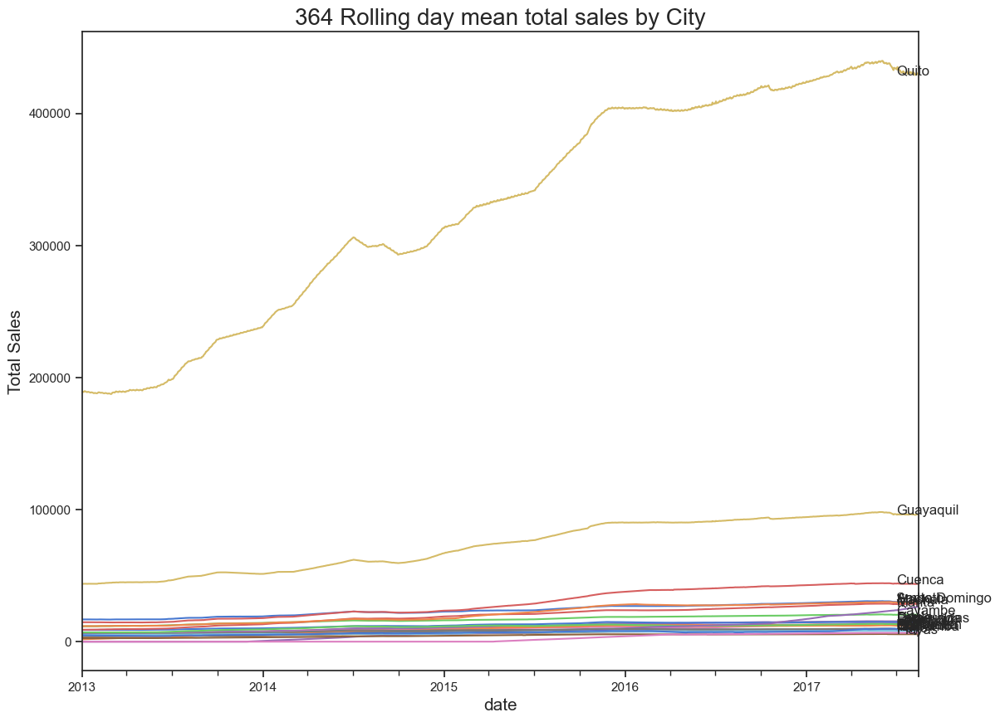

In [34]:
city_dly_sales = train_df.groupby(
    ["city", "date"], as_index=False)["sales"].sum()

fig, ax = plt.subplots(figsize=(13, 10))
roll_period = 365

for city in city_dly_sales["city"].unique():

    roll_mean = \
        city_dly_sales.query(f"city == '{city}'").set_index("date").\
        rolling(roll_period, center=True, min_periods=30)["sales"].mean().to_frame(f"{city}")

    roll_mean.plot(ax=ax, legend=None)

    xy_coord = roll_mean.reset_index().iloc[-1, :].values

    ax.annotate(text=city,
                xy=xy_coord,
                xytext=xy_coord + np.array([-pd.Timedelta("45 days"), 100]))

plt.ylabel("Total Sales")
plt.title("364 Rolling day mean total sales by City");

The city of *Quito* has the highest total sales compared to any other cities.

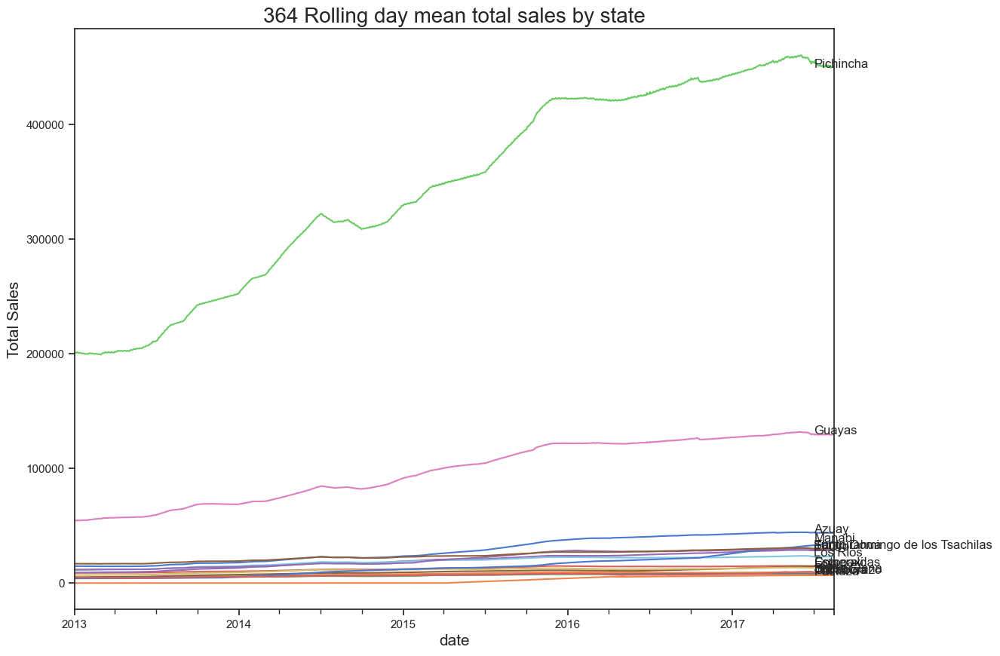

In [35]:
state_dly_sales = train_df.groupby(
    ["state", "date"], as_index=False)["sales"].sum()

fig, ax = plt.subplots(figsize=(13, 10))
roll_period = 365

for state in state_dly_sales["state"].unique():

    roll_mean = \
        state_dly_sales.query(f"state == '{state}'").set_index("date").\
        rolling(roll_period, center=True, min_periods=30)["sales"].mean().to_frame(f"{state}")

    roll_mean.plot(ax=ax, legend=None)

    xy_coord = roll_mean.reset_index().iloc[-1, :].values

    ax.annotate(text=state,
                xy=xy_coord,
                xytext=xy_coord + np.array([-pd.Timedelta("45 days"), 100]))

plt.ylabel("Total Sales")
plt.title("364 Rolling day mean total sales by state");

In [36]:
store_df.groupby(["state", "city"])["store_nbr"].count()

state                           city         
Azuay                           Cuenca            3
Bolivar                         Guaranda          1
Chimborazo                      Riobamba          1
Cotopaxi                        Latacunga         2
El Oro                          Machala           2
Esmeraldas                      Esmeraldas        1
Guayas                          Daule             1
                                Guayaquil         8
                                Libertad          1
                                Playas            1
Imbabura                        Ibarra            1
Loja                            Loja              1
Los Rios                        Babahoyo          1
                                Quevedo           1
Manabi                          El Carmen         1
                                Manta             2
Pastaza                         Puyo              1
Pichincha                       Cayambe           1
                  

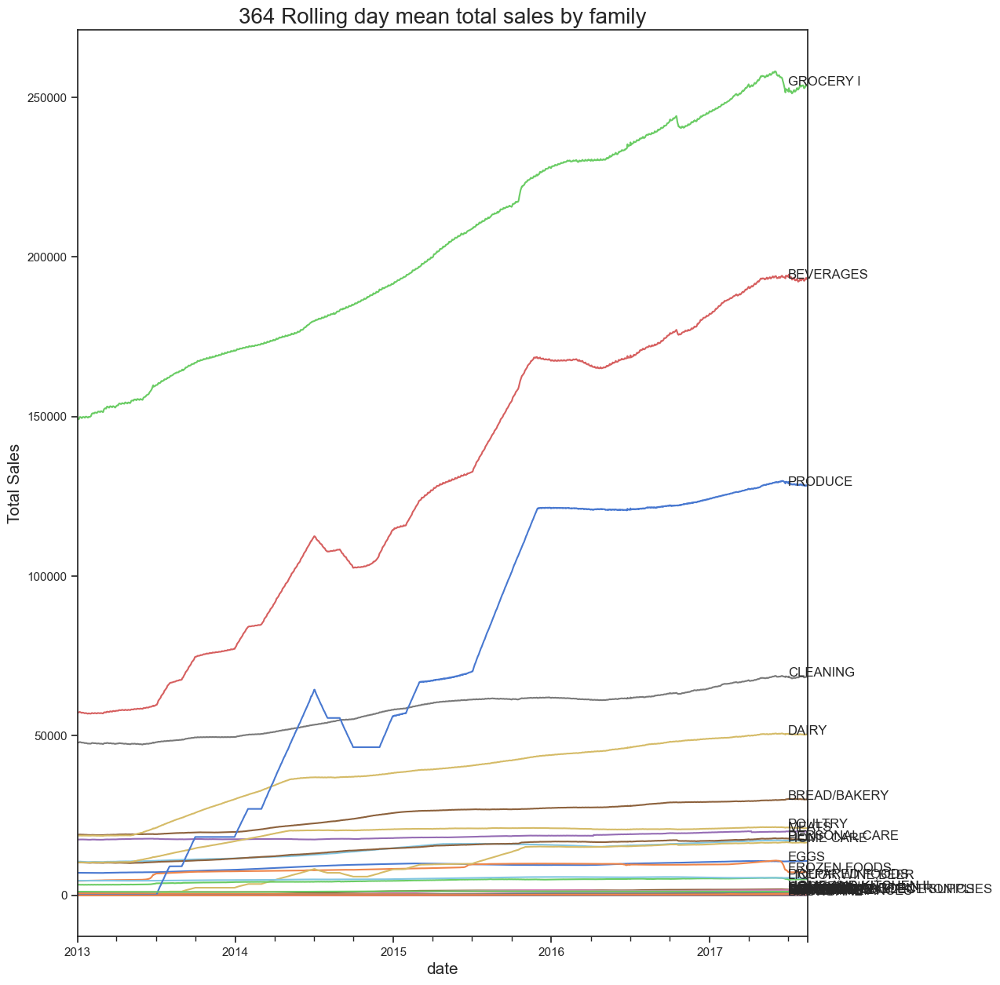

In [37]:
family_total_dly_sales = \
    train_df.groupby(["family", "date"], as_index=False)["sales"].sum()

fig, ax = plt.subplots(figsize=(12, 15))
roll_period = 365

for prd in family_total_dly_sales["family"].unique():

    roll_mean = \
        family_total_dly_sales.query(f"family == '{prd}'").set_index("date").\
        rolling(roll_period, center=True, min_periods=30)["sales"].mean().to_frame(f"{prd}")

    roll_mean.plot(ax=ax, legend=None)

    xy_coord = roll_mean.reset_index().iloc[-1, :].values

    ax.annotate(text=prd,
                xy=xy_coord,
                xytext=xy_coord + np.array([-pd.Timedelta("45 days"), 100]))

plt.ylabel("Total Sales")
plt.title("364 Rolling day mean total sales by family");

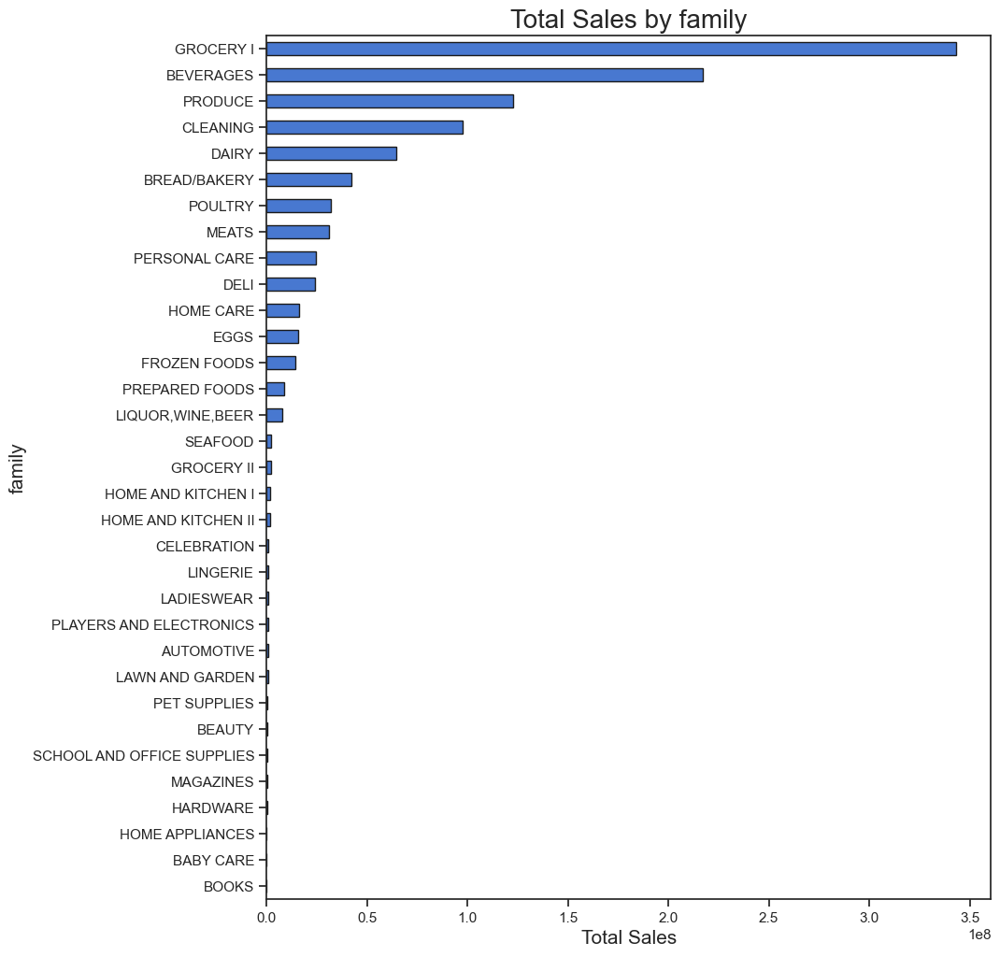

In [38]:
fig, ax = plt.subplots(figsize=(10, 12))

train_df.groupby("family")["sales"].sum().sort_values().\
    plot(kind="barh", ax=ax, edgecolor="k", title="Total Sales by family")

ax.set_xlabel("Total Sales")
ax.set_ylabel("family");

The most selling product family is Grocery I, followed by beverages and produce.

# Visualizing Total Sales by type of days

In [39]:
# Creating variables for each type of day

weekends = set(train_df.loc[train_df["is_weekend"], "date"])

#Events
earthquake = set(holiday_df.loc[holiday_df["description"].str.contains(r'Terremoto Manabi'),"date"])
futbol = set(holiday_df.loc[holiday_df["description"].str.contains(r'futbol'),"date"])
moms_day = set(holiday_df.query("description.str.contains(r'Dia de la Madre')", engine="python")["date"])
blk_fri = set(holiday_df.query("description.str.contains(r'Black Friday')", engine="python")["date"])
cyb_mon = set(holiday_df.query("description.str.contains(r'Cyber Monday')", engine="python")["date"])

#Holidays
transfer_dates = set(holiday_df.loc[holiday_df["type"].eq("Transfer"), "date"])

xmas_hol_extra=\
set(
    holiday_df.query("date.dt.day!=25 and description.str.contains(r'navidad', case=False)", 
                     engine='python')['date']
)

christmas = set(holiday_df.query("date.dt.month==12 and date.dt.day==25")['date'])
new_year = set(holiday_df.query("date.dt.day==1 and date.dt.month==1", engine='python')['date'])

national_holidays_1 = \
earthquake.union(
    cyb_mon, blk_fri, moms_day, transfer_dates, futbol, new_year, christmas, xmas_hol_extra
)

national_holidays_2 = \
    set(
        holiday_df.loc[
            ~holiday_df["date"].isin(national_holidays_1) & holiday_df["locale"].eq("National"), 
            "date"
        ]
    )

reg_holidays = set(holiday_df.query("locale=='Regional'")["date"])
local_holidays = set(holiday_df.query("locale=='Local'")["date"])

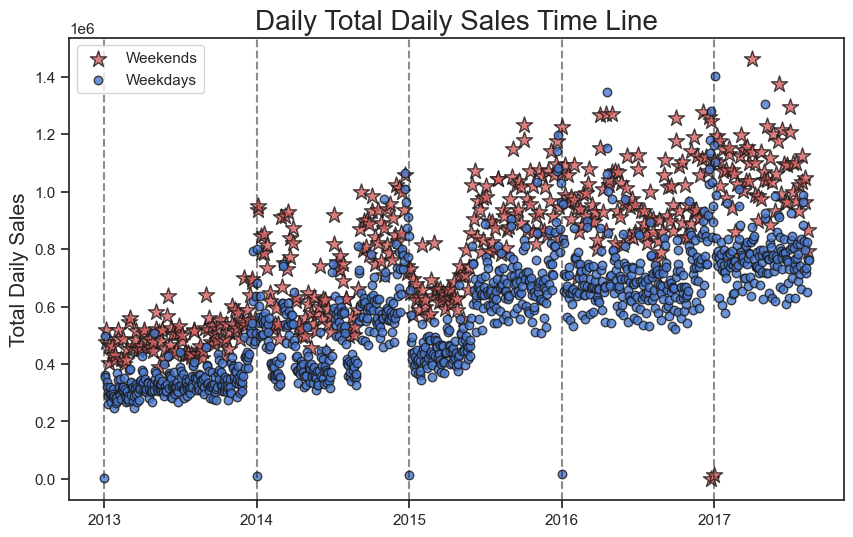

In [40]:
fig, ax = plt.subplots(figsize=(10, 6))

args = dict(x="date",
            y="sales",
            kind="scatter",
            edgecolor="k",
            ax=ax,
            alpha=0.8,
            s=150)

# weekends
total_daily_sales[total_daily_sales.index.isin(weekends)].reset_index().\
    plot(**args, marker="*", color="r", label="Weekends")

# Weekdays
total_daily_sales[~total_daily_sales.index.isin(weekends)
                  & ~total_daily_sales.index.isin(christmas)].reset_index(
).plot(**args, color="b", label="Weekdays", marker=".")

ax.set_ylabel("Total Daily Sales")
ax.set_xlabel("")
ax.set_title("Daily Total Daily Sales Time Line")

for newyear in pd.date_range("2013-01-01", "2017-01-01", freq="YS"):
    ax.axvline(newyear, color="k", alpha=0.5, ls="--")

The above plot show the daily total sales (regardless of any stores). The plots illustrates that sales on weekdays are significantly lower than sales on weekends. The sales falls to the lowest during New Year - be it on a weekday or weekend.

Now, I will add certain holidays over the plot and see how sales are affected according to the type of holiday/event.

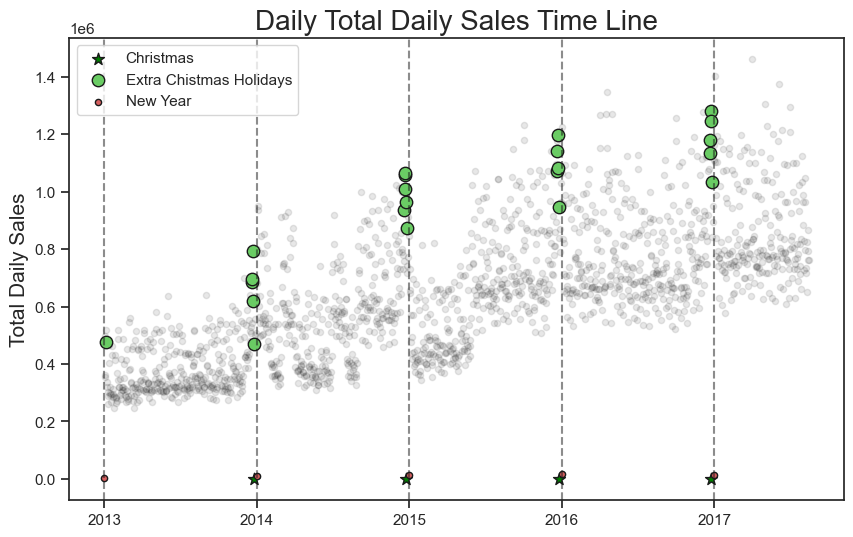

In [41]:
fig, ax = plt.subplots(figsize=(10, 6))

args = dict(x="date",
            y="sales",
            kind="scatter",
            edgecolor="k",
            ax=ax,
            s=80)


total_daily_sales.reset_index().plot(**args, marker=".", alpha=0.1, color="k")

# christmas
total_daily_sales[total_daily_sales.index.isin(christmas)].reset_index().\
    plot(**args, color="green", label="Christmas", marker='*')

total_daily_sales[total_daily_sales.index.isin(xmas_hol_extra)].reset_index().\
    plot(**args, color="g", label="Extra Chistmas Holidays")

total_daily_sales[total_daily_sales.index.isin(new_year)].reset_index().\
    plot(**args, color="r", label="New Year", marker='.')


ax.set_ylabel("Total Daily Sales")
ax.set_xlabel("")
ax.set_title("Daily Total Daily Sales Time Line")

for newyear in pd.date_range("2013-01-01", "2017-01-01", freq="YS"):
    ax.axvline(newyear, color="k", alpha=0.5, ls="--")

During Christmas days (additional days and actual chistmas day, from 21 to 26 Dec), there is sharp increase in sales.

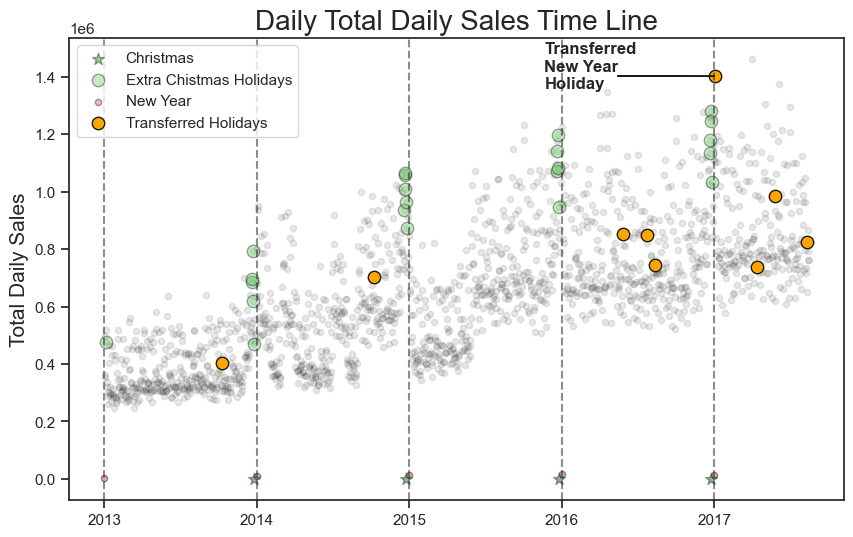

In [42]:
fig, ax = plt.subplots(figsize=(10, 6))

args = dict(x="date",
            y="sales",
            kind="scatter",
            edgecolor="k",
            ax=ax,
            s=80)

total_daily_sales.reset_index().plot(**args, marker=".", alpha=0.1, color="k")

# christmas
total_daily_sales[total_daily_sales.index.isin(christmas)].reset_index().\
    plot(**args, color="green", label="Christmas", alpha=0.4, marker='*')

#Extra chistmas holidays
total_daily_sales[total_daily_sales.index.isin(xmas_hol_extra)].reset_index().\
    plot(**args, color="g", label="Extra Chistmas Holidays", alpha=0.4)

#New Year
total_daily_sales[total_daily_sales.index.isin(new_year)].reset_index().\
    plot(**args, color="r", label="New Year", marker='.', alpha=0.4)

# Transferred Holidays
total_daily_sales[total_daily_sales.index.isin(transfer_dates)].reset_index().\
    plot(**args, color="orange", label="Transferred Holidays")


ax.annotate("Transferred\nNew Year\nHoliday",
            xy=(pd.to_datetime("2017-01-02"), 1.402306e+06),
            xytext=(pd.to_datetime("2015-11-21"), 1.36e+06),
            fontsize=12,
            fontweight="bold")


ax.arrow(x=pd.to_datetime("2017-01-02"),
         y=1.402306e+06,
         dx=-10,
         dy=20,
         head_length=500,
         fc='k',
         ec='k')


ax.set_ylabel("Total Daily Sales")
ax.set_xlabel("")
ax.set_title("Daily Total Daily Sales Time Line")

for newyear in pd.date_range("2013-01-01", "2017-01-01", freq="YS"):
    ax.axvline(newyear, color="k", alpha=0.5, ls="--")

Sales on Transferred days mostly depends on whether that day falls on a weekday or weekend.There was one exception where a new year on 2017 was transferred to the 2nd of Jan 2017. This particular day saw high sales.

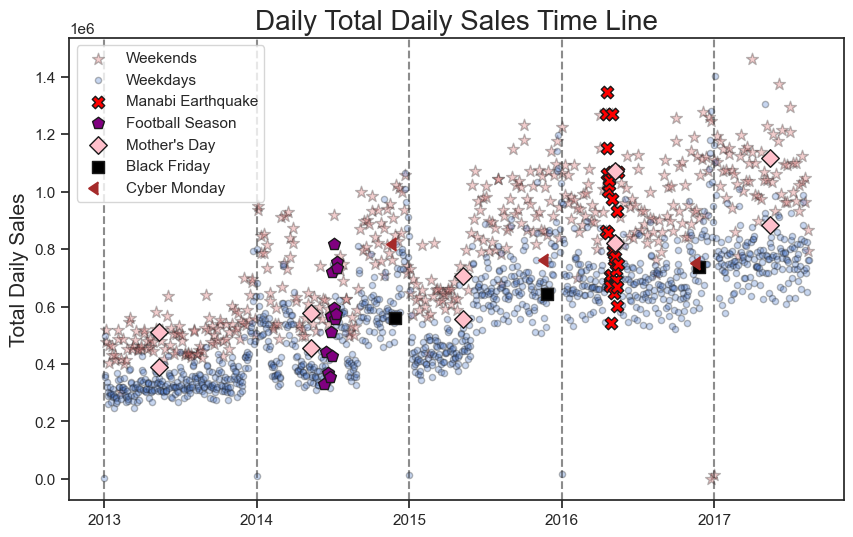

In [43]:
fig, ax = plt.subplots(figsize=(10, 6))

args = dict(x="date",
            y="sales",
            kind="scatter",
            edgecolor="k",
            ax=ax,
            s=80)


# weekends
total_daily_sales[total_daily_sales.index.isin(weekends)].reset_index().\
    plot(**args, marker="*", color="r", label="Weekends", alpha=0.3)

# Weekdays
total_daily_sales[~total_daily_sales.index.isin(weekends)
                  & ~total_daily_sales.index.isin(christmas)].reset_index(
).plot(**args, color="b", label="Weekdays", marker=".", alpha=0.3)


# Earthquake Event
total_daily_sales[total_daily_sales.index.isin(earthquake)].reset_index().\
    plot(**args, color="red", marker="X", label="Manabi Earthquake")

# Footbal Event
total_daily_sales[total_daily_sales.index.isin(futbol)].reset_index().\
    plot(**args, color="purple", marker="p", label="Football Season")

# Mothers day
total_daily_sales[total_daily_sales.index.isin(moms_day)].reset_index().\
    plot(**args, color="Pink", marker="D", label="Mother's Day")

# Black Friday
total_daily_sales[total_daily_sales.index.isin(blk_fri)].reset_index().\
    plot(**args, color="black", marker="s", label="Black Friday")

# Cyber Monday
total_daily_sales[total_daily_sales.index.isin(cyb_mon)].reset_index().\
    plot(**args, color="brown", marker=8, label="Cyber Monday")

ax.set_ylabel("Total Daily Sales")
ax.set_xlabel("")
ax.set_title("Daily Total Daily Sales Time Line")

for newyear in pd.date_range("2013-01-01", "2017-01-01", freq="YS"):
    ax.axvline(newyear, color="k", alpha=0.5, ls="--")

The above plot illustrates the effect of certain events on total daily sales. It seems like the sales is mostly affected by the weekday or weekend rather than the actual event itself. If the event falls on a weekday, the sales remains normal as of any other weekday. Whereas if the event falls on a weekend, the sales is noticeably higher. The only significant sales are seen during the April 2016 Manabi earthquake. Highest sales are seen on weekend during the earthquake event.

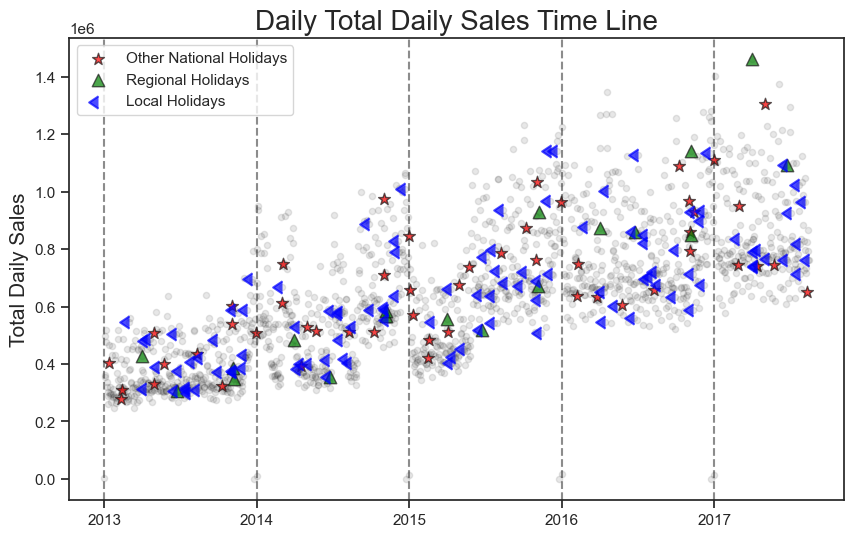

In [44]:
fig, ax = plt.subplots(figsize=(10, 6))

args = dict(x="date",
            y="sales",
            kind="scatter",
            edgecolor="k",
            ax=ax,
            s=80)

total_daily_sales.reset_index().plot(**args, marker=".", alpha=0.1, color="k")

# Other National Holidays
total_daily_sales[total_daily_sales.index.isin(national_holidays_2)].reset_index().\
    plot(**args, color="red", marker="*", label="Other National Holidays", alpha=0.7)

# Other regional Holidays
total_daily_sales[total_daily_sales.index.isin(reg_holidays)].reset_index().\
    plot(**args, color="green", marker="^", label="Regional Holidays", alpha=0.7)

# Other Local Holidays
total_daily_sales[total_daily_sales.index.isin(local_holidays)].reset_index().\
    plot(**args, color="blue", marker=8, label="Local Holidays", alpha=0.7)


ax.set_ylabel("Total Daily Sales")
ax.set_xlabel("")
ax.set_title("Daily Total Daily Sales Time Line")

for newyear in pd.date_range("2013-01-01", "2017-01-01", freq="YS"):
    ax.axvline(newyear, color="k", alpha=0.5, ls="--")

The above plots show remaining holidays. These holidays do not necessarily affect sales (depends on whether the holiday falls on a weekday or weekend).

In [45]:
total_daily_sales = total_daily_sales.to_frame()

#Holidays
total_daily_sales.loc[total_daily_sales.index.isin(christmas), "is_christmas"] = True
total_daily_sales.loc[total_daily_sales.index.isin(xmas_hol_extra), "is_xmas_hol_extra"] = True
total_daily_sales.loc[total_daily_sales.index.isin(new_year), "is_new_year"] = True
total_daily_sales.loc[total_daily_sales.index.isin(transfer_dates), "is_transferred"] = True
total_daily_sales.loc[total_daily_sales.index.isin(national_holidays_2), "is_other_nat_holidays"] = True
total_daily_sales.loc[total_daily_sales.index.isin(reg_holidays), "is_reg_holidays"] = True
total_daily_sales.loc[total_daily_sales.index.isin(local_holidays), "is_local_holidays"] = True

#Events
total_daily_sales.loc[total_daily_sales.index.isin(earthquake), "is_earthquake"] = True
total_daily_sales.loc[total_daily_sales.index.isin(cyb_mon), "is_cybermonday"] = True
total_daily_sales.loc[total_daily_sales.index.isin(blk_fri), "is_blackfriday"] = True
total_daily_sales.loc[total_daily_sales.index.isin(moms_day), "is_momsday"] = True
total_daily_sales.loc[total_daily_sales.index.isin(futbol), "is_football"] = True


# total_daily_sales.loc[total_daily_sales.index.isin(events), "is_event"] = True
# events = earthquake.union(cyb_mon, blk_fri, moms_day, futbol)

total_daily_sales.head()

,sales,is_christmas,is_xmas_hol_extra,is_new_year,is_transferred,is_other_nat_holidays,is_reg_holidays,is_local_holidays,is_earthquake,is_cybermonday,is_blackfriday,is_momsday,is_football
date,,,,,,,,,,,,,
2013-01-01,2511.618999,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-02,496092.417944,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-03,361461.231124,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-04,354459.677093,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-05,477350.121229,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [46]:
non_holidays = \
    total_daily_sales[["is_christmas", "is_xmas_hol_extra", "is_new_year", "is_transferred", 
                       "is_other_nat_holidays", "is_reg_holidays", "is_local_holidays", "is_earthquake", 
                       "is_cybermonday", "is_blackfriday", "is_momsday", "is_football"]].isnull().\
        apply(lambda x: all(x), axis = 1)

total_daily_sales.loc[non_holidays, "is_non_holiday"] = True

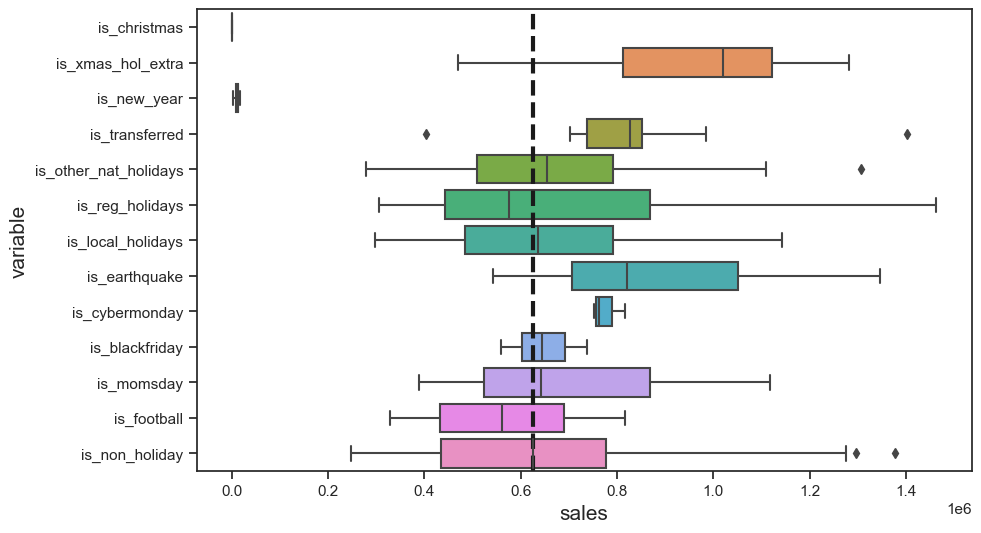

In [47]:
daytype_sales = \
    total_daily_sales.reset_index().melt(id_vars=["date", "sales"]).dropna().drop("value", axis=1)

plt.figure(figsize=(10, 6))

ax = sns.boxplot(x="sales", y="variable", data=daytype_sales, orient="h");

ax.axvline(daytype_sales.query("variable == 'is_non_holiday'")["sales"].median(), 
           color="k", linestyle="--", lw=3);

The above boxplots shows the distribution of sales for each say category. 

Both Christmas and New year shows the lowest sales in a year.

Extra Christmas holidays, transferred holidays and events drives up sales compared to non-holidays (non holidays includes both weekends and weekdays). Other holidays does not affect sales much. Other holidays are mostly made of holidays celebrated at a local city/state level (not national holidays).

In [48]:
daytype_sales["is_weekend"] = daytype_sales["date"].dt.day_of_week > 4

In [49]:
daytype_sales

,date,sales,variable,is_weekend
358,2013-12-25,0.000000,is_christmas,False
723,2014-12-25,0.000000,is_christmas,False
1088,2015-12-25,0.000000,is_christmas,False
1454,2016-12-25,0.000000,is_christmas,True
1692,2013-01-05,477350.121229,is_xmas_hol_extra,True
...,...,...,...,...
21936,2017-08-08,717766.349106,is_non_holiday,False
21937,2017-08-09,734139.674010,is_non_holiday,False
21940,2017-08-12,792630.535079,is_non_holiday,True
21941,2017-08-13,865639.677471,is_non_holiday,True


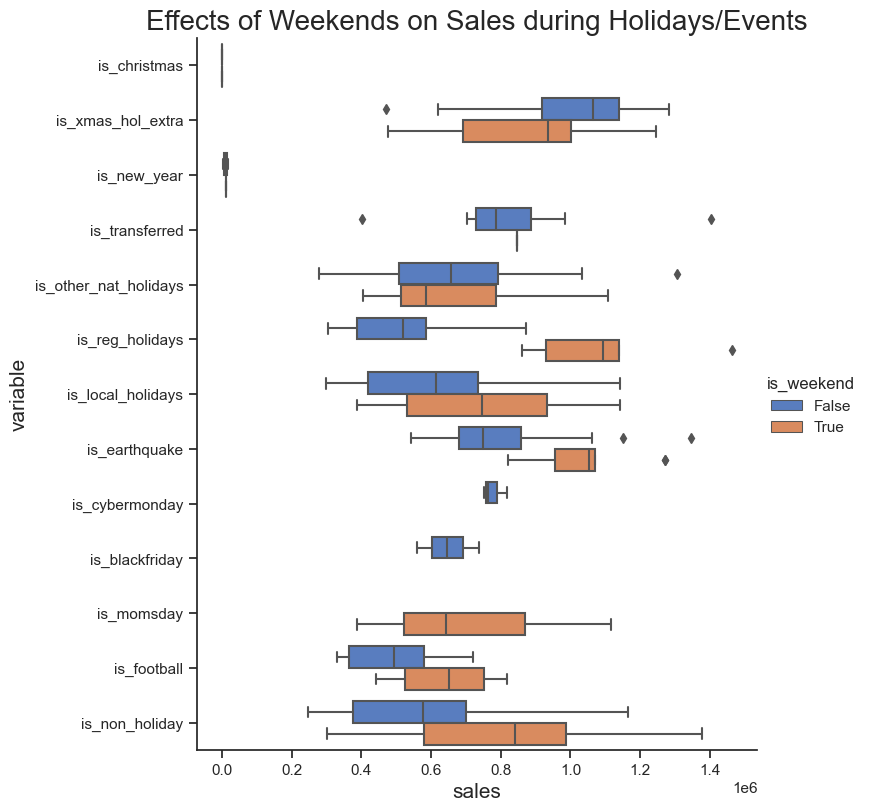

In [50]:
sns.catplot(
    x="sales",
    y="variable",
    data=daytype_sales, 
    orient="h",
    kind="box",
    hue="is_weekend",
    aspect=1,
    height=8
);

plt.title("Effects of Weekends on Sales during Holidays/Events");

The above plots shows the how sales differ across all holidays/events during weekdays and weekends.

* During extra Christmas holidays and other national holidays, median sales are higher during weekdays.
* For the rest of the holidays/events, sales are higher on weekends.
* Cyber monday and black friday always falls on weekdays, whereas moms day always falls on weekend.

# Store group types

In [51]:
train_df_storetype = train_df.groupby(["date", "type"], as_index=False)["sales"].sum()
train_df_storetype

,date,type,sales
0,2013-01-01,A,0.000000
1,2013-01-01,B,0.000000
2,2013-01-01,C,0.000000
3,2013-01-01,D,2511.618999
4,2013-01-01,E,0.000000
...,...,...,...
8435,2017-08-15,A,220464.355977
8436,2017-08-15,B,122307.633986
8437,2017-08-15,C,141869.223000
8438,2017-08-15,D,215126.683976


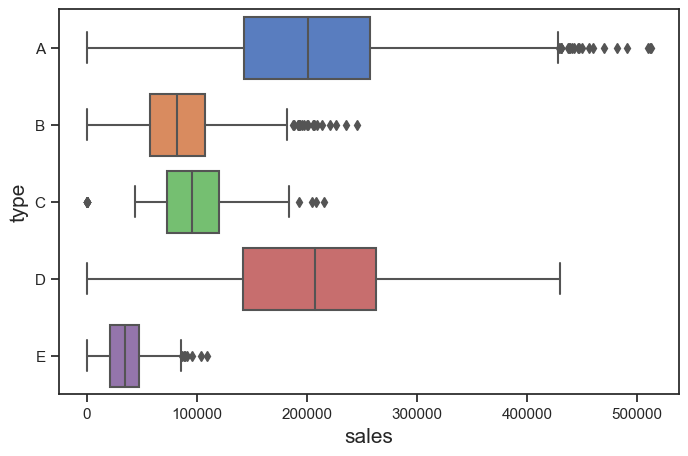

In [52]:
fig, ax = plt.subplots(figsize=(8, 5))

sns.boxplot(x="sales", y="type", data=train_df_storetype, orient="h");

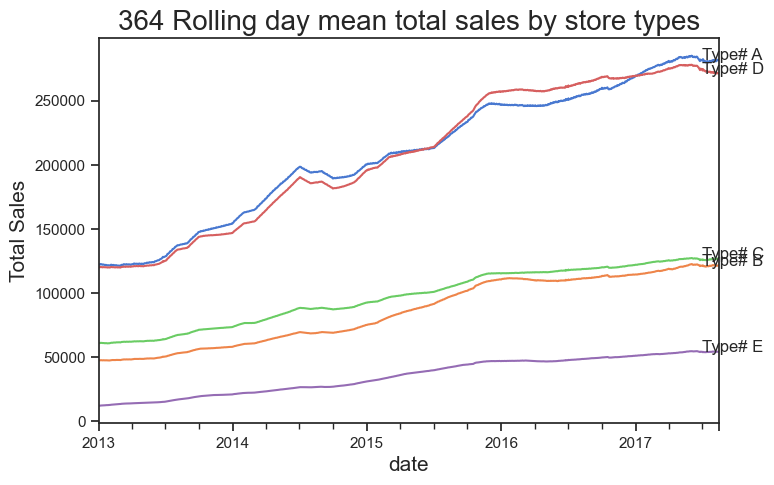

In [53]:
fig, ax = plt.subplots(figsize=(8, 5))
roll_period = 365

for store in train_df_storetype["type"].unique():

    roll_mean = \
        train_df_storetype.query(f"type == '{store}'").set_index("date").\
        rolling(roll_period, center=True, min_periods=30)["sales"].mean().to_frame(f"{store}")

    roll_mean.plot(ax=ax, legend=None)

    xy_coord = roll_mean.reset_index().iloc[-1, :].values

    ax.annotate(text=f"Type# {store}",
                xy=xy_coord,
                xytext=xy_coord + np.array([-pd.Timedelta("45 days"), 100]))

plt.ylabel("Total Sales")
plt.title("364 Rolling day mean total sales by store types");

Not sure whether the store type will be a useful feature as it depends on the store number itself.

# Promotion

In [54]:
train_df["is_promotion"] = np.where(train_df["onpromotion"].eq(0), 0, 1)

Mean: is_promotion
0     157.776039
1    1137.693730
Name: sales, dtype: float64

Median: is_promotion
0      3.0
1    373.0
Name: sales, dtype: float64


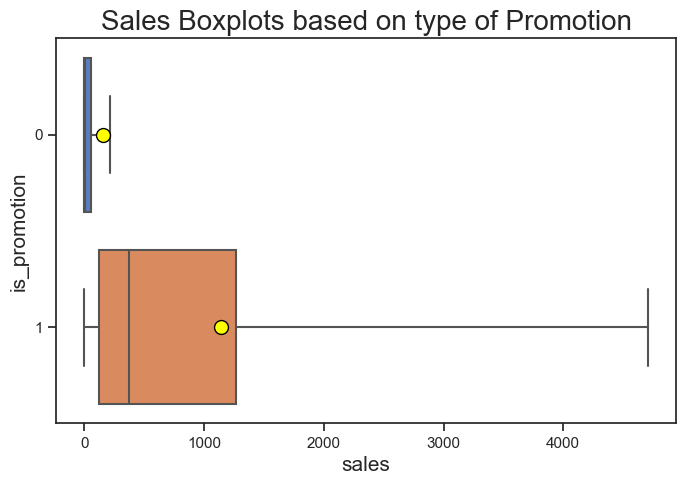

In [55]:
print(f'Mean: {train_df.groupby("is_promotion")["sales"].mean()}')
print()
print(f'Median: {train_df.groupby("is_promotion")["sales"].median()}')

fig, ax = plt.subplots(figsize=(8, 5))

sns.boxplot(x="sales",
            y="is_promotion",
            data=train_df,
            orient="h",
            whis=3,
            showfliers=False,
            showmeans=True,
            meanprops={
                "marker": "o",
                "markerfacecolor": "yellow",
                "markeredgecolor": "black",
                "markersize": "10"
            },
            ax=ax)

# sns.stripplot(x="sales", y="is_promotion", data=train_df, orient="h", ax=ax, color="k", 
#               alpha=0.1)

ax.set_title("Sales Boxplots based on type of Promotion");

Sales is affected by promotion

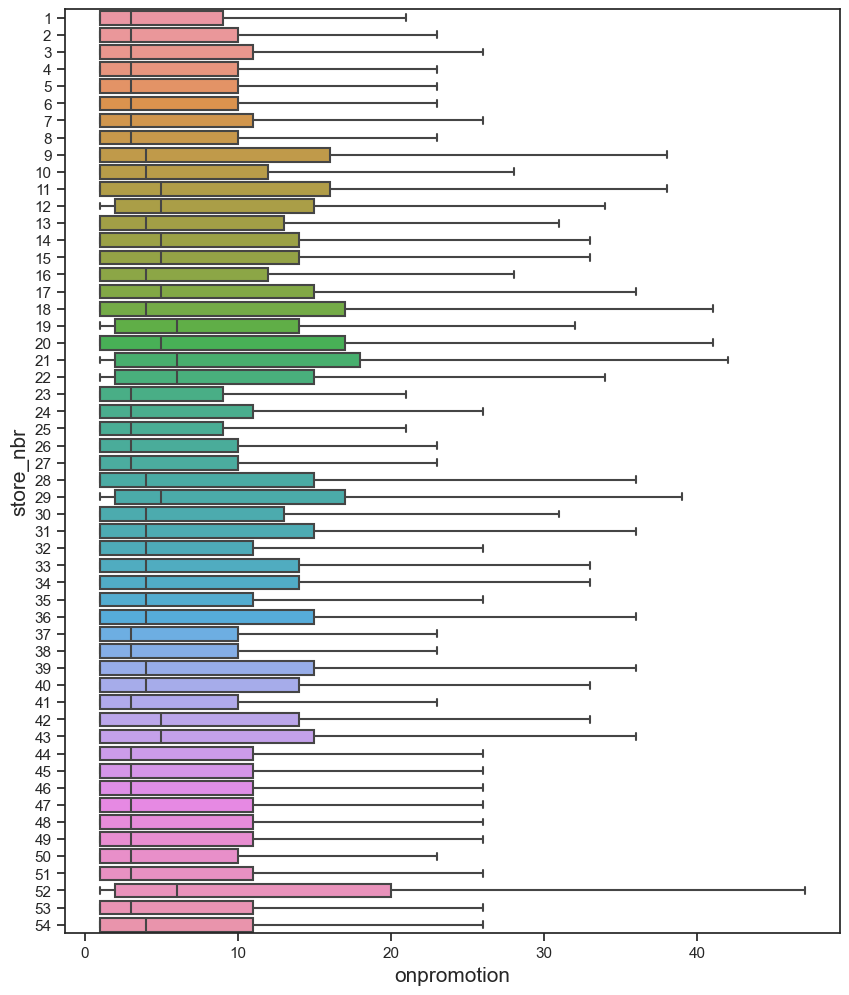

In [56]:
plt.figure(figsize=(10, 12))

sns.boxplot(x="onpromotion",
            y="store_nbr",
            data=train_df.query("is_promotion == 1"),
            orient="h",
            showfliers=False);

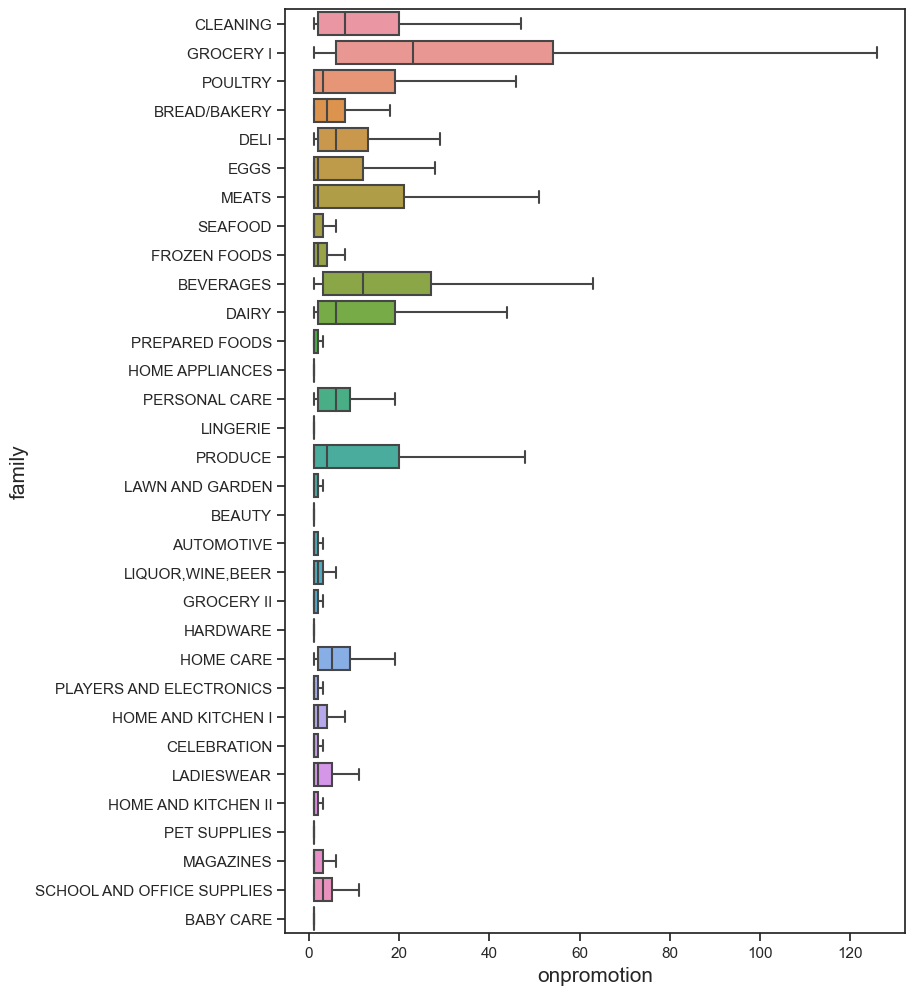

In [57]:
plt.figure(figsize=(8, 12))

sns.boxplot(x="onpromotion",
            y="family",
            data=train_df.query("is_promotion == 1"),
            orient="h",
            showfliers=False);

The promotion differs by both stores and the family. Most of the promotions depends on certain types of products, mainly GROCERY I, BEVERAGES, CLEANING, PRODUCE, DAIRY etc.

### Promotion by day, month, etc

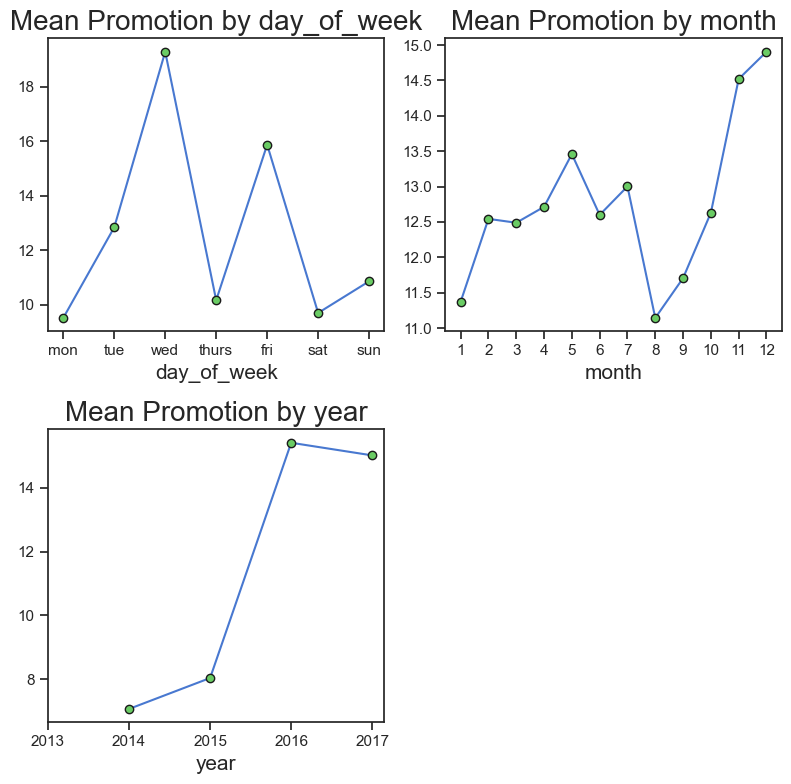

In [58]:
fig, axes = plt.subplots(2, 2, tight_layout=True, figsize=(8, 8))

for col, ax in zip(["day_of_week", "month", "year"], axes.flatten()):

    train_df.query("is_promotion==1").groupby(col)["onpromotion"].mean().\
        plot(ax=ax, marker="o", mfc="g", mec="k")
    
    ax.set_title(f"Mean Promotion by {col}")

    if col in ["year", "month"]:
        ax.set_xticks(train_df.groupby(col)["onpromotion"].mean().index)
    else:
        ax.set_xticks(train_df.groupby(col)["onpromotion"].mean().index, days)
        
axes.flatten()[-1].set_axis_off()

* **day**: There is no noticable seasonal pattern during days within a month. Probably there are higher promotions during month-end.

* **month**: Promotions are lowest during Jan and Aug. Promotions are highest on Dec and Nov.

* **year**: There were no promotions during 2013. From 2014 pnwards, the mean promotions has been increasing significantly.

* **week**: In a week, Promotons are lowest on monday, followed by thursday and weekends. Promotions are highest on Wednesday and Friday. This probably because sales are naturally high during weekends, without the need for promotions. Therefore in order to incentivize people to buy more during certain weekdays, promotions are usually on certain weekdays.

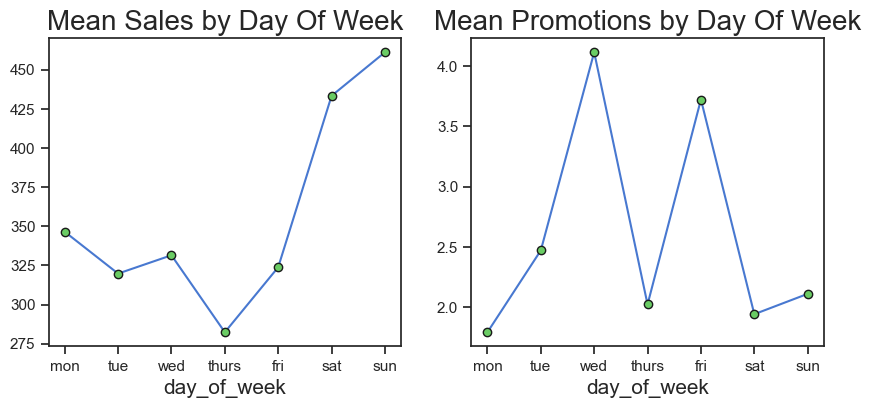

In [59]:
fig, ax = plt.subplots(1, 2, figsize=(10, 4))

train_df.groupby("day_of_week")['sales'].mean().plot(ax=ax[0], marker="o", mfc="g", mec="k")
ax[0].set_title("Mean Sales by Day Of Week")
ax[0].set_xticks(train_df.groupby("day_of_week")['sales'].mean().index, days)

train_df.groupby("day_of_week")['onpromotion'].mean().plot(ax=ax[1], marker="o", mfc="g", mec="k")
ax[1].set_title("Mean Promotions by Day Of Week")
ax[1].set_xticks(train_df.groupby("day_of_week")['onpromotion'].mean().index, days);

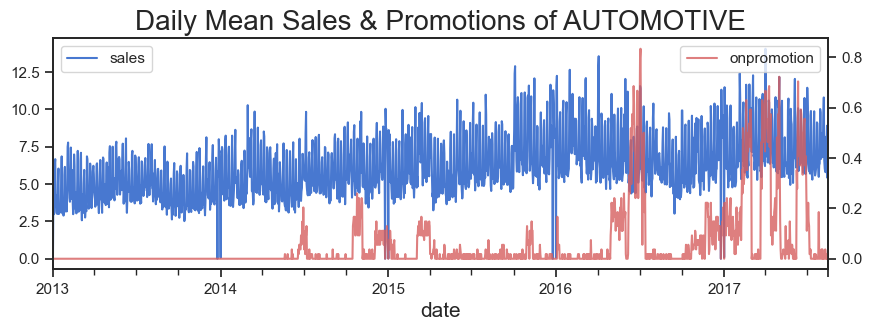

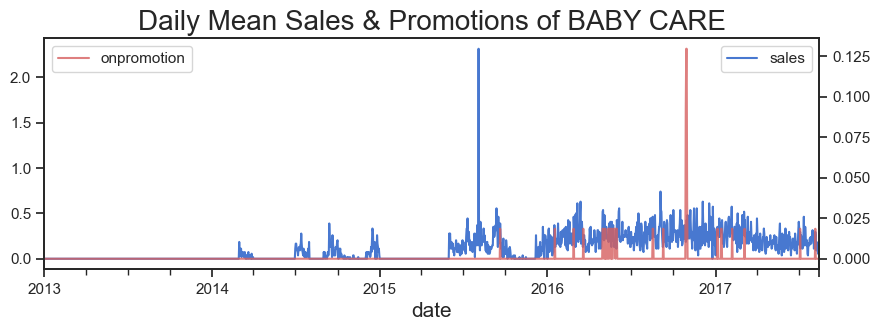

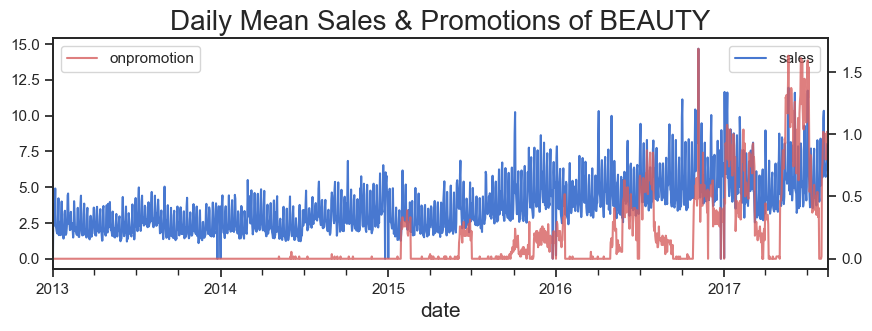

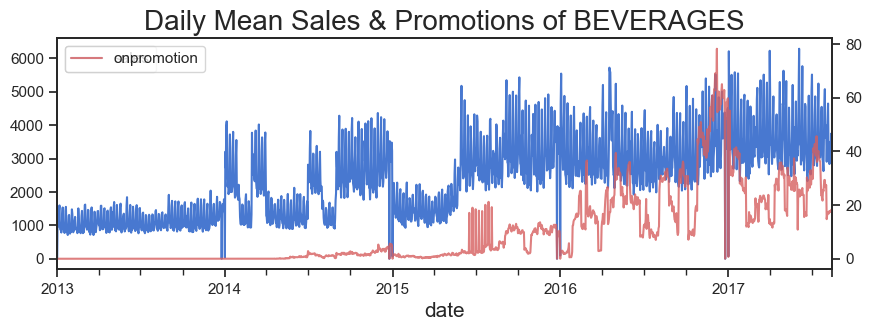

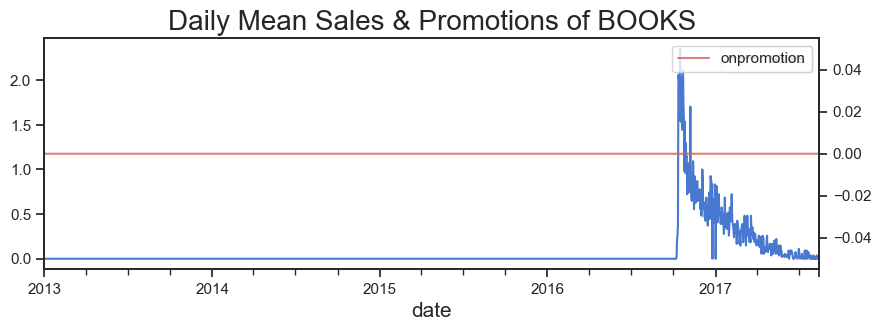

...

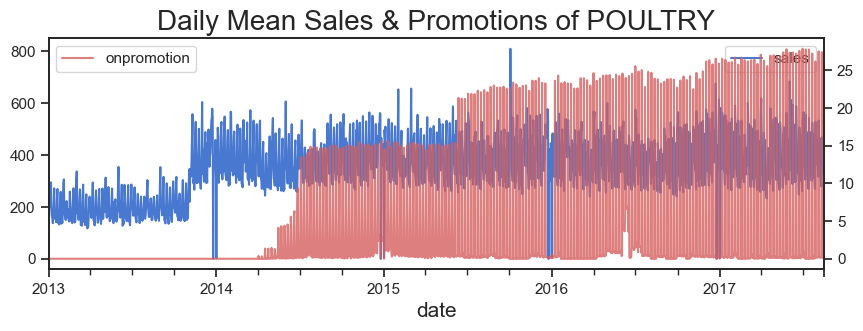

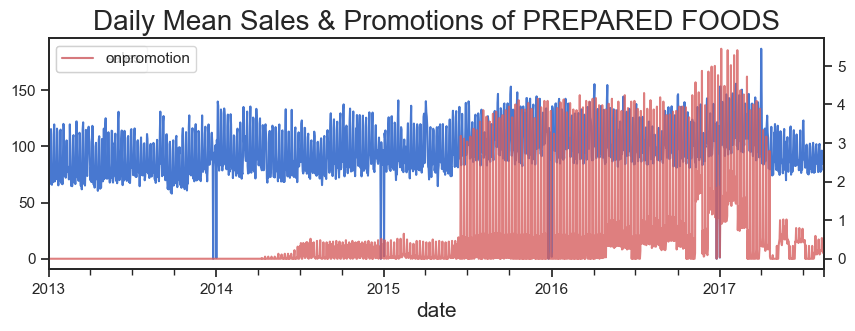

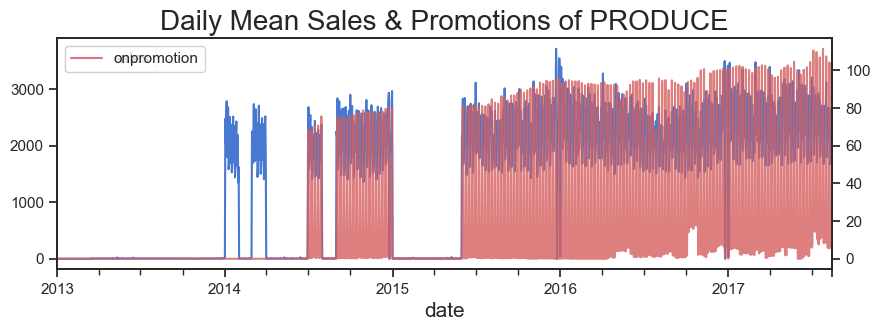

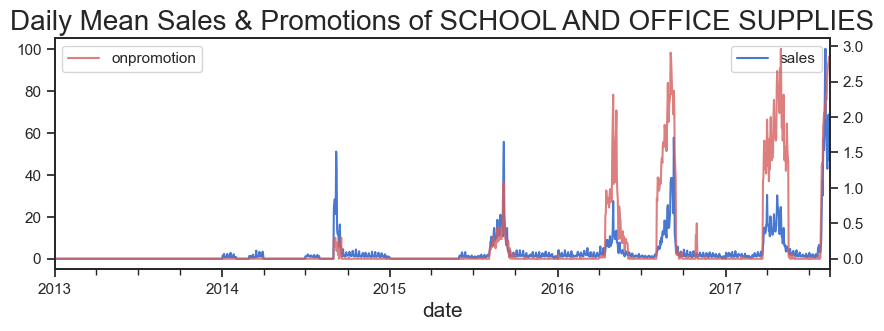

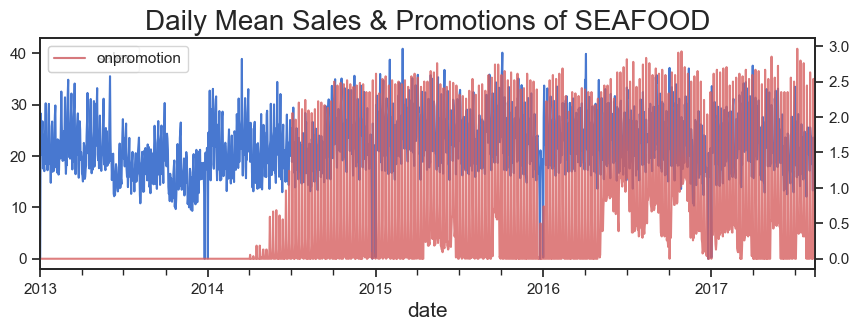

In [161]:
for prd in train_df['family'].unique():
    
    fig, ax1 = plt.subplots()

    ax2 = ax1.twinx()
    
    train_df.groupby(["date", "family"], as_index=False)['sales'].mean().\
        query(f"family=='{prd}'").plot(x='date', y='sales', figsize=(10, 3), ax=ax1, c='b')
    
    train_df.groupby(["date", "family"], as_index=False)['onpromotion'].mean().query(f"family=='{prd}'").\
        plot(x='date', y='onpromotion', figsize=(10, 3), ax=ax2, c='r', alpha=0.8)
    
    plt.title(f'Daily Mean Sales & Promotions of {prd}')
    plt.show();

# Promotion Timeline

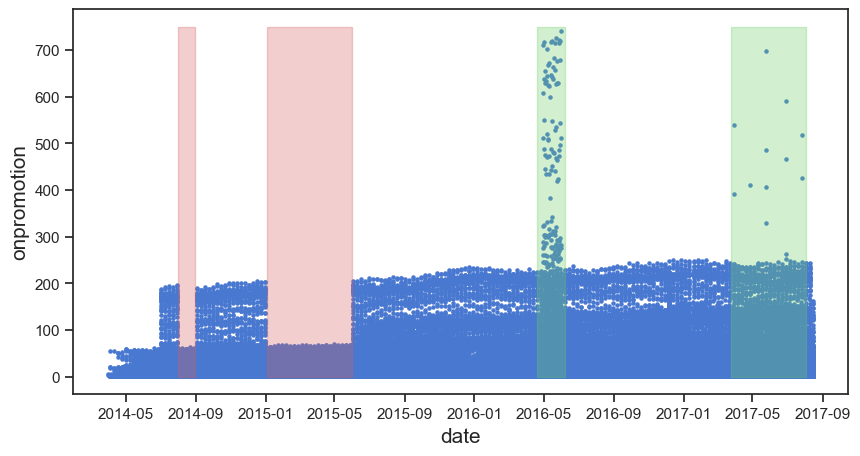

In [61]:
# Daily promotions time series

train_df.query("onpromotion > 0").\
    plot(x="date", y="onpromotion", kind="scatter",
         color="b", figsize=(10, 5), marker=".", legend=None)

plt.fill_between(
    (pd.to_datetime("2016-04-20"), pd.to_datetime("2016-06-7")), 
    750,
    alpha=0.3, 
    color="g"
)

plt.fill_between(
    (pd.to_datetime("2017-03-24"), pd.to_datetime("2017-08-02")), 
    750,
    alpha=0.3, 
    color="g"
)

plt.fill_between(
    (pd.to_datetime("2015-01-03"), pd.to_datetime("2015-06-01")), 
    750,
    alpha=0.3, 
    color="r"
)

plt.fill_between(
    (pd.to_datetime("2014-08-01"), pd.to_datetime("2014-08-31")), 
    750,
    alpha=0.3, 
    color="r"
);

The above plot shows the daily time series promotions. Promotions begins after 2014. There are 4 interesting periods where promotions very low (regions shaded in red) and where promotions very very high (regions shaded in green).

In the next sections, I will analyze these shaded regions.

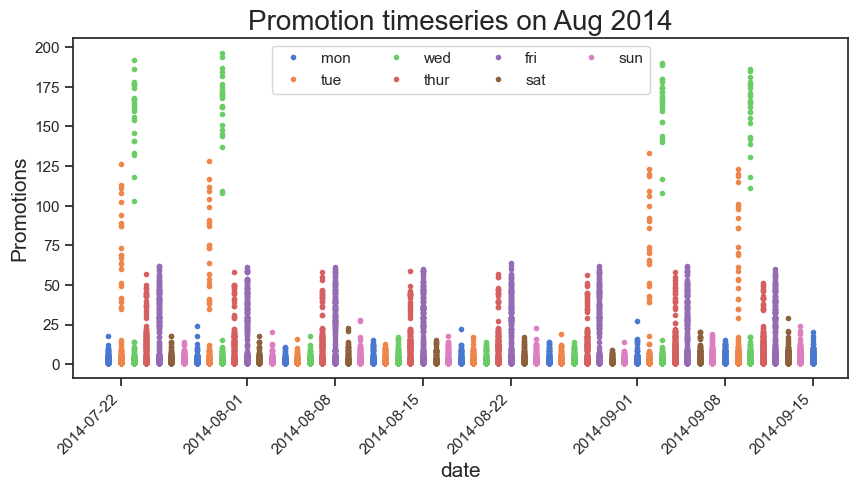

In [62]:
fig, ax = plt.subplots(figsize=(10, 5))

for i in range(0, 7, 1):
    train_df.query(f"onpromotion>0 and date>='2014-07-21' and date<='2014-09-15' and day_of_week=={i}").\
    plot(x="date", y="onpromotion", linestyle="", marker=".", rot=45, ax=ax, label=i);
    
ax.legend(labels=["mon", "tue", "wed", "thur", "fri", "sat", "sun"], ncol=4);

ax.set_title("Promotion timeseries on Aug 2014")
ax.set_ylabel("Promotions");

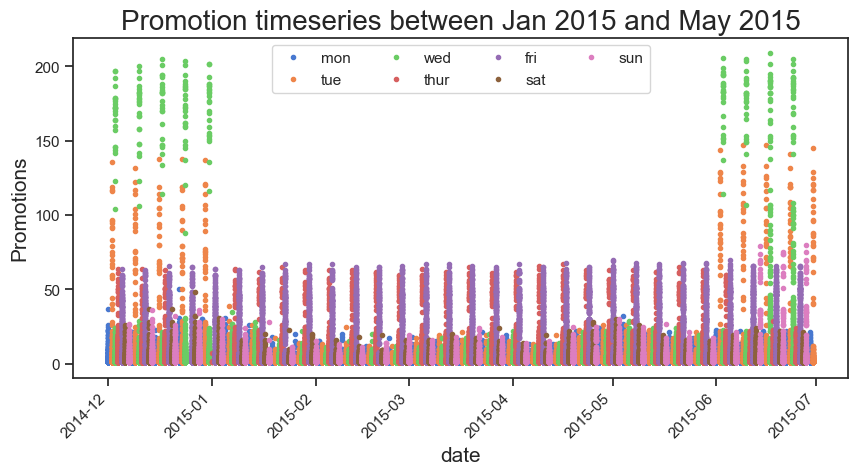

In [63]:
fig, ax = plt.subplots(figsize=(10, 5))

for i in range(0, 7, 1):
    train_df.query(f"onpromotion>0 and date>='2014-12-01' and date<='2015-06-30' and day_of_week=={i}").\
        plot(x="date", y="onpromotion", linestyle="", marker=".", rot=45, ax=ax, label=i);
    
ax.legend(labels=["mon", "tue", "wed", "thur", "fri", "sat", "sun"], ncol=4);

ax.set_title("Promotion timeseries between Jan 2015 and May 2015")
ax.set_ylabel("Promotions");

From the above 2 plots, it is clear that during those 2 periods, the promotions offered during Tuesdays and Wednesdays were much lower than what was usually offered on these days.

Most likely, the **sales were much lower too during these 2 periods.**

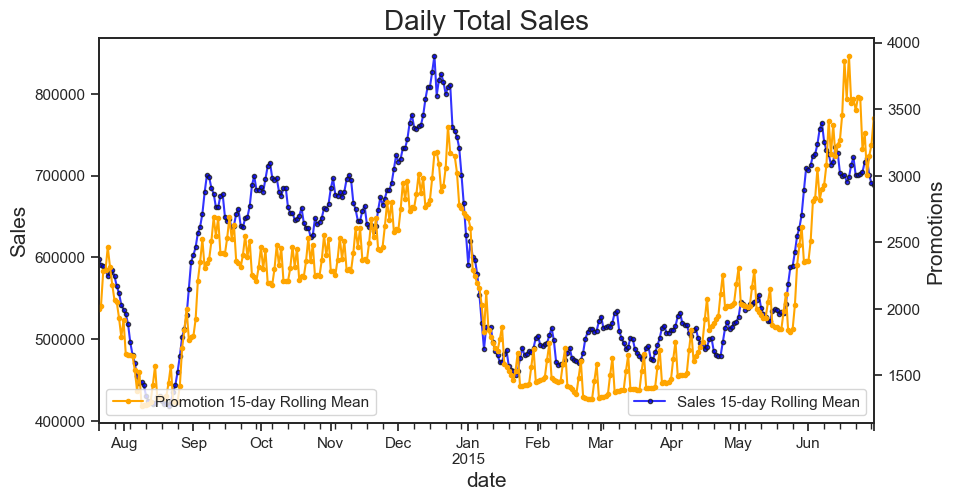

In [64]:
rolling_period=15

fig, ax1 = plt.subplots(figsize=(10, 5))
ax2 = ax1.twinx()

#Sales
total_daily_sales.query("date>='2014-07-21' and date<='2015-06-30'").\
    rolling(rolling_period, center=True, min_periods=1).mean().\
        plot(y="sales", marker=".", alpha=0.8, mec='k', ax=ax1, color="blue")

#Promotion
train_df.groupby("date")["onpromotion"].sum().to_frame().\
    query(f"onpromotion>0 and date>='2014-07-21' and date<='2015-06-30'").\
        rolling(rolling_period, center=True, min_periods=1).mean().\
            plot(y="onpromotion", marker=".", rot=45, ax=ax2, color="orange", legend=None);

ax1.legend(labels=[f"Sales {rolling_period}-day Rolling Mean"], loc="lower right")
ax2.legend(labels=[f"Promotion {rolling_period}-day Rolling Mean"], loc="lower left")

ax1.set_title("Daily Total Sales")
ax1.set_ylabel("Sales")
ax2.set_ylabel("Promotions");

The above plot compares the rolling mean time series of both sales and promotions. It is clear that Sales depends on the promotions. When promotions are low, sales drop too. 

### Promotions between April 2016 and May 2016 - Manabi Earthquke event

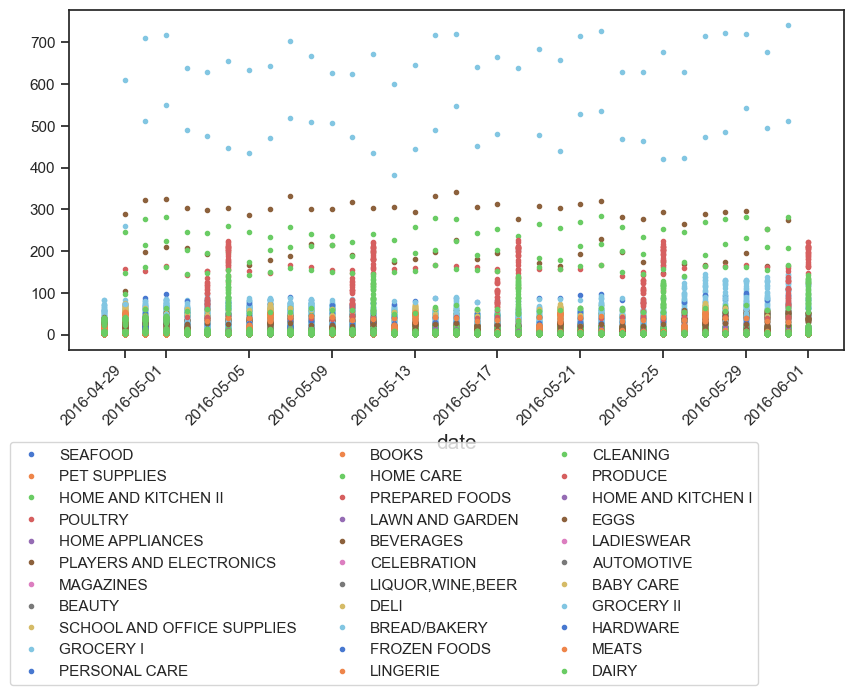

In [65]:
fig, ax = plt.subplots(figsize=(10, 5))

for prd in set(train_df["family"]):

    train_df.query(
        f"onpromotion > 0 and date >= '2016-04-28' and date <= '2016-06-01' and family == '{prd}'"
    ).plot(x="date",
           y="onpromotion",
           linestyle="",
           marker=".",
           legend=None,
           rot=45,
           ax=ax,
           label=f"{prd}")

plt.legend(ncol=3, bbox_to_anchor=(0.9, -0.25));

In [66]:
train_df.query("onpromotion > 0 and date >= '2016-04-28' and date <= '2016-06-01'").\
    groupby(["store_nbr", "family"], as_index=False)["onpromotion"].mean().\
        sort_values("onpromotion", ascending=False).head(8)

,store_nbr,family,onpromotion
1086,53,GROCERY I,635.171429
1118,54,GROCERY I,440.457143
1078,53,BEVERAGES,285.485714
1081,53,CLEANING,241.314286
1113,54,CLEANING,183.628571
1110,54,BEVERAGES,170.485714
1104,53,PRODUCE,157.911765
1082,53,DAIRY,146.657143


In [67]:
store_df.query("store_nbr in (53, 54)")

,store_nbr,city,state,type,cluster
52,53,Manta,Manabi,D,13
53,54,El Carmen,Manabi,C,3


On 16 April 2018, an **earthquake** struck the state of Manabi. The main stores located in Manabi are 53 & 54. Hence both of these stores were giving high promotions for a whole month after the disaster for certain family products such as GROCERY I, BEVERAGES, CLEANING, PRODUCE, DAIRY, etc.

In [68]:
store_df.query("state=='Manabi'")
#There are 3 stores in Manabi. What about store 52?

,store_nbr,city,state,type,cluster
51,52,Manta,Manabi,A,11
52,53,Manta,Manabi,D,13
53,54,El Carmen,Manabi,C,3


In [69]:
train_df.query("store_nbr == 52 and date >= '2016-04-16' and date <= '2016-06-01'")["onpromotion"].sum()

0

Store 52, which is also located in Manabi, gave no promotions during this time period.

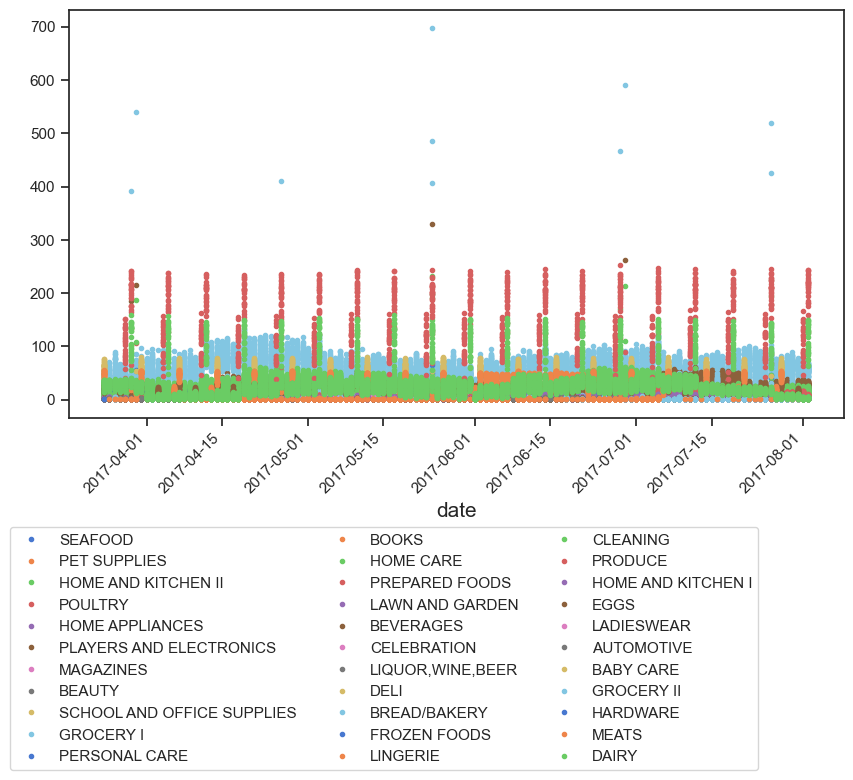

In [70]:
fig, ax = plt.subplots(figsize=(10, 6))

for prd in set(train_df["family"]):

    train_df.query(
        f"onpromotion > 0 and date >= '2017-03-24' and date <= '2017-08-02' and family == '{prd}'"
    ).plot(x="date",
           y="onpromotion",
           linestyle="",
           marker=".",
           legend=None,
           rot=45,
           ax=ax,
           label=f"{prd}")

plt.legend(ncol=3, bbox_to_anchor=(0.9, -0.25));

In [71]:
train_df.query("onpromotion > 280 and date >= '2017-03-24' and date <= '2017-08-02'").\
    sort_values("date")[["date", "store_nbr", "family", "onpromotion", "state", "city"]]

,date,store_nbr,family,onpromotion,state,city
2759670,2017-03-29,35,GROCERY I,391,Guayas,Playas
2761386,2017-03-30,33,GROCERY I,539,Los Rios,Quevedo
2809566,2017-04-26,35,GROCERY I,411,Guayas,Playas
2858835,2017-05-24,16,GROCERY I,486,Santo Domingo de los Tsachilas,Santo Domingo
2859462,2017-05-24,35,GROCERY I,407,Guayas,Playas
2859486,2017-05-24,36,BEVERAGES,330,Guayas,Libertad
2859495,2017-05-24,36,GROCERY I,697,Guayas,Libertad
2921205,2017-06-28,16,GROCERY I,467,Santo Domingo de los Tsachilas,Santo Domingo
2923548,2017-06-29,33,GROCERY I,591,Los Rios,Quevedo
2971101,2017-07-26,16,GROCERY I,519,Santo Domingo de los Tsachilas,Santo Domingo


Not clear why these stores were giving high promotions for certain products.

# Total Sales vs Total Promotions

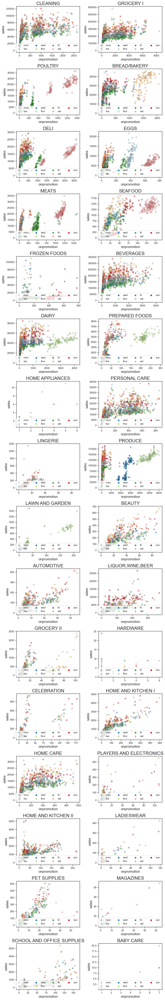

In [74]:
tot_sales_promot_family = \
    train_df.query("onpromotion != 0").\
    groupby(["date", "family"], as_index=False)[["sales", "onpromotion"]].sum()

tot_sales_promot_family["dayofweek"] = tot_sales_promot_family[
    "date"].dt.dayofweek

fig, axes = plt.subplots(16, 2, tight_layout=True, figsize=(10, 60))

for prd, ax in zip(tot_sales_promot_family["family"].unique(), axes.flatten()):

    sns.scatterplot(
        x="onpromotion",
        y="sales",
        data=tot_sales_promot_family.query(f"family == '{prd}'"),
        edgecolor="k",
        alpha=0.5,
        hue="dayofweek",
        ax=ax,
        palette="Paired",
    )

    ax.set_title(prd)
    ax.legend(labels=["mon", "tue", "wed", "thur", "fri", "sat", "sun"],
              loc="lower right",
              ncol=4)

Overall, when aggregating by taking the sum of daily sales and promotions, we can see both promotions and the day the promotions was offered influences the sales of certain products.

# Sales vs oil price

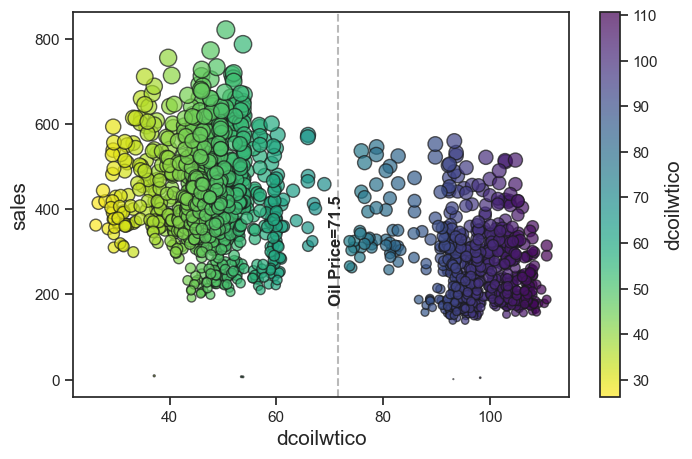

In [75]:
fig, ax = plt.subplots(figsize=(8, 5))

agg_df = train_df.set_index("date")[["sales", "onpromotion"]].resample("D").mean().\
            join(oil_df_imputed).fillna(method="ffill")

size = agg_df["sales"]/5

agg_df.plot(x="dcoilwtico",
            y="sales",
            kind="scatter",
            edgecolor="k",
            alpha=0.7,
            c="dcoilwtico",
            cmap='viridis_r',
            ax=ax,
            s=size)

ax.axvline(71.5, linestyle="--", color="k", alpha=0.3);
ax.text(x=69.8, y=180, s="Oil Price=71.5", rotation=90, fontsize="medium", fontweight="bold");

The above plot is a scatter plot between mean daily sales and daily oil prices. There seems to be **2 clusters** within the plot - **One with a higher concentration of high sales and lower oil prices, the other cluster with lower concentraion of lowsales and higher oil price**.

In [76]:
#Median Sales when Oil price lower than 71.5
agg_df.query("dcoilwtico < 71.5")["sales"].median()

412.75038075350733

In [77]:
#Median Sales when Oil price higher than 71.5
agg_df.query("dcoilwtico >= 71.5")["sales"].median()

241.2278469229798

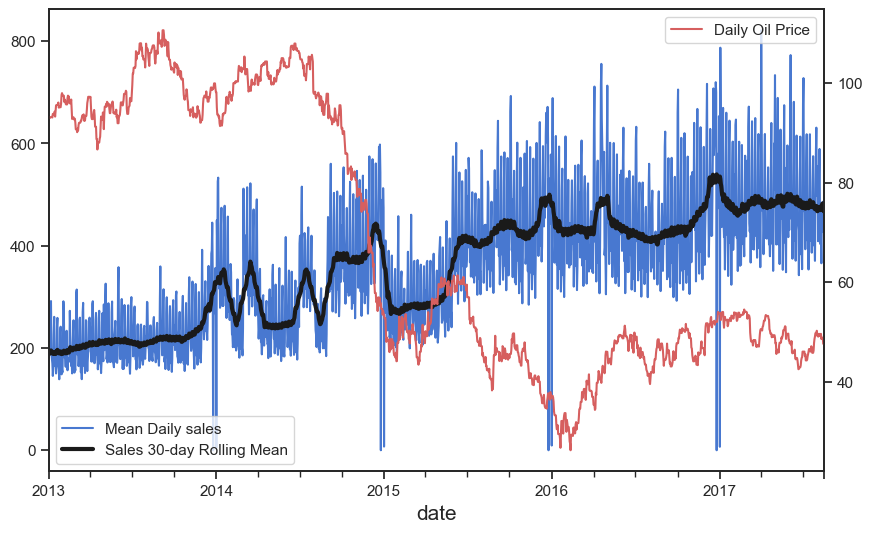

In [78]:
fig, ax1 = plt.subplots(figsize=(10, 6))
ax2 = ax1.twinx()

agg_df.plot(y="sales", ax=ax1, color="b", label="Mean Daily sales")

agg_df.rolling(30, center=True, min_periods=7).mean().\
    plot(y="sales", ax=ax1, color="k", label="Sales 30-day Rolling Mean", lw=3,)

agg_df.plot(y="dcoilwtico", ax=ax2, color="r", label="Daily Oil Price");

ax1.legend(loc="lower left");

It is **not apparent whether oil prices affect sales**. Although there is a sharp decrease in oil price, there is no dramatic increase of sales as a result.

##### Note: The double downward spike seen on the plot above represents total sales on christmas (0 sales) and new year.

The increases in sales during the period where oil prices are lower could be perhaps attributed to increasing trend of sales. More analysis needs to be done in order to establish a causal relation between oil price and sales.

In the next section, I will use statistical tests to determine whether both `onpromotion` and `dcoilwtico` variables influences `sales` variable.

### Decomposing  Total Daily Sales, Oil Price and Promotions to make them stationary.

One of the prerequisites for all of the tests is to ensure the time series are stationary - i.e, there are no trend or seasonal components. 

For both `sales` and `onpromotion` variables, I will use [MSTL](https://www.statsmodels.org/dev/generated/statsmodels.tsa.seasonal.MSTL.html#statsmodels.tsa.seasonal.MSTL) (Multiple Seasonal-Trend decomposition using LOESS) method to extract trend, seasonal (#Weekly, monthly, quaterly and yearly seasonality) and residual components. 

Since the residual component is free from trend and seasonality, this component will be used for the tests. 

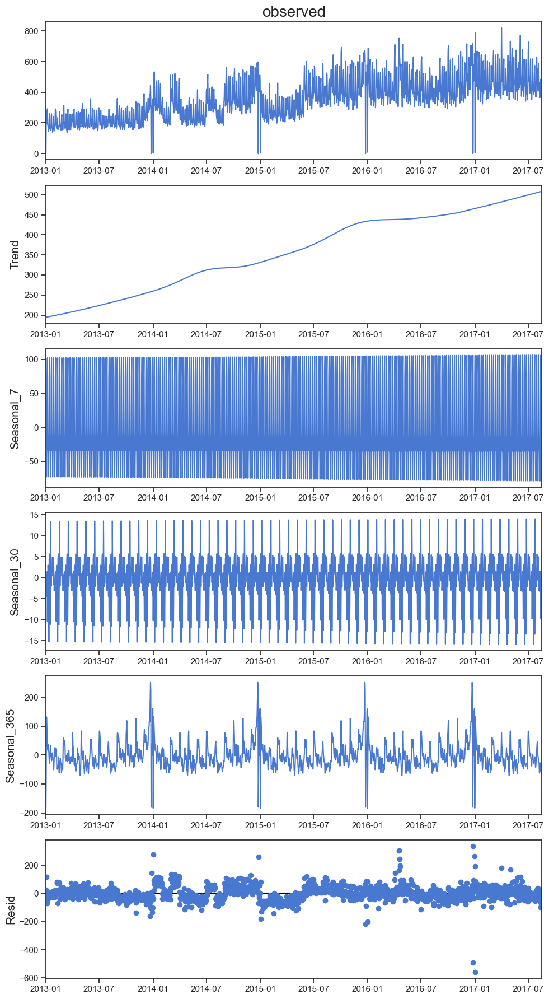

In [79]:
#Decomposing Sales
mstl = MSTL(agg_df["sales"], 
            periods=(7, 30, 365), #Weekly, monthly, and yearly seasonality
            windows=[501, 201, 51],
            stl_kwargs={
                "seasonal_deg":0, # Means the seasonal smoother is fit with a moving average.
               }
           )

res=mstl.fit()

fig = res.plot()
fig.set_size_inches((10, 18))
fig.tight_layout()

In [80]:
agg_df["sales_resid"] = res.resid

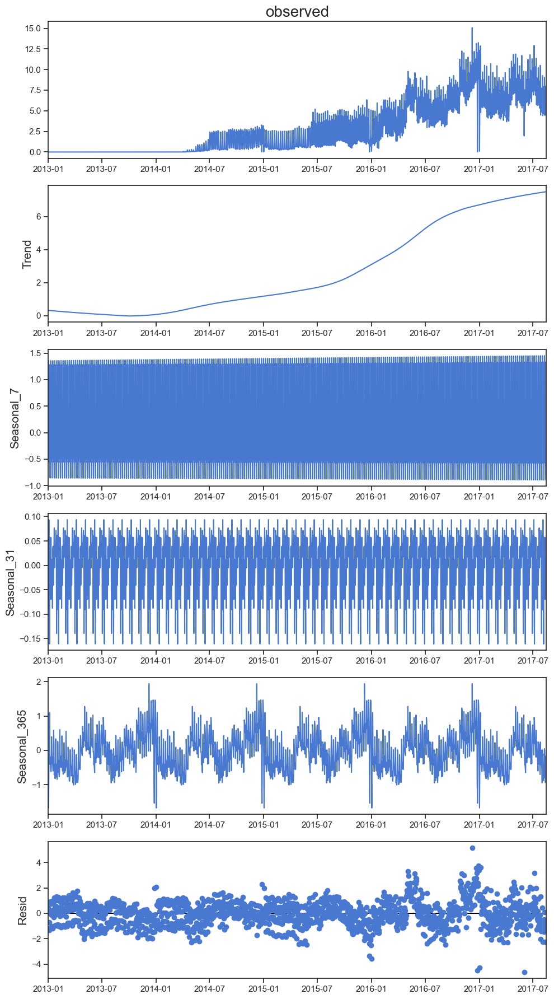

In [81]:
#Decomposing onpromotion
mstl = MSTL(agg_df["onpromotion"], 
            periods=(7, 31, 365), #Weekly, monthly, and yearly seasonality
            windows=[1001, 1001, 1001],
            stl_kwargs={
                "seasonal_deg":0, # Means the seasonal smoother is fit with a moving average.
               }
           )

res=mstl.fit()

fig = res.plot()
fig.set_size_inches((10, 18))
fig.tight_layout()

In [82]:
agg_df["promotion_resid"] = res.resid

for oil price variable, since there is no discernible trend or seasonal component, I will simply difference this variable to make it stationary. 

In [83]:
agg_df["oilprice_diff"] = agg_df["dcoilwtico"].diff()

In order to ensure all time series are stationary,  [Augmented Dickey-Fuller](https://www.statsmodels.org/dev/generated/statsmodels.tsa.stattools.adfuller.html) test will be used. 

"*The null hypothesis of the Augmented Dickey-Fuller is that there is a unit root, with the alternative that there is no unit root. If the pvalue is above a critical size, then we cannot reject that there is a unit root.*"

**The presence of a unit root means the time series is non-stationary**

In [84]:
def ADFtest(series, alpha):
    
    result = adfuller(series, autolag='AIC')
    p_val = result[1]
    print(f'ADF Statistic: {result[0]}')
    print(f'n_lags: {result[1]}')
    print(f'p-value: {p_val:.10f}')
    print()
    
    for key, value in result[4].items():
        print('Critial Values:')
        print(f'   {key}, {value}')    
    
    print()
    if p_val < alpha:
        print(f"P-Value lower than alpha. Unit root does not exist. Hence Time series is Stationary")
    else:
        print(f"P-Value greater than alpha. Unit root does exist. Hence Time series is Not Stationary")

In [85]:
#check for stationarity for sales_resid
ADFtest(series=agg_df["sales_resid"] , alpha=0.01)

ADF Statistic: -5.639289928285845
n_lags: 1.0454735938517306e-06
p-value: 0.0000010455

Critial Values:
   1%, -3.434283579780684
Critial Values:
   5%, -2.863277451883613
Critial Values:
   10%, -2.5676949772294817

P-Value lower than alpha. Unit root does not exist. Hence Time series is Stationary


In [86]:
#check for stationarity for oilprice_diff
ADFtest(series=agg_df["oilprice_diff"].dropna(), alpha=0.01)

ADF Statistic: -43.482525978383045
n_lags: 0.0
p-value: 0.0000000000

Critial Values:
   1%, -3.4342345101144467
Critial Values:
   5%, -2.8632557920255
Critial Values:
   10%, -2.56768344369724

P-Value lower than alpha. Unit root does not exist. Hence Time series is Stationary


In [87]:
#check for stationarity for promotion_resid
ADFtest(series=agg_df["promotion_resid"] , alpha=0.01)

ADF Statistic: -4.413126194411608
n_lags: 0.00028135151551101083
p-value: 0.0002813515

Critial Values:
   1%, -3.434288317816291
Critial Values:
   5%, -2.863279543282764
Critial Values:
   10%, -2.5676960908695463

P-Value lower than alpha. Unit root does not exist. Hence Time series is Stationary


#### All 3 time series are stationary.

# Granger Causality test

The Null hypothesis for grangercausalitytests is that the time series in the second column, x2, does NOT Granger cause the time series in the first column, x1. Grange causality means that past values of x2 have a statistically significant effect on the current value of x1, taking past values of x1 into account as regressors. We reject the null hypothesis that x2 does not Granger cause x1 if the pvalues are below a desired size of the test.

In [88]:
def granger_causality_test(x, maxlag, alpha):

    results = grangercausalitytests(x=x.dropna(), maxlag=maxlag, verbose=True)

    res_dict = [{
        "lag": i + 1,
        "Pval": results[i + 1][0]["ssr_ftest"][1]
    } for i in range(maxlag)]

    pd.options.display.float_format = '{:.6f}'.format
    res_dict_df = pd.DataFrame(res_dict).set_index("lag")

    print()
    print(
        f"Are there any significant P-Value?: {any(res_dict_df['Pval'] < alpha)}"
    )

#     return res_dict_df
    col0 = x.columns[0]
    col1 = x.columns[1]
    
    fig, ax = plt.subplots(figsize=(10, 6))
    
    res_dict_df.plot(kind="bar", ax=ax, rot=0, edgecolor="k", alpha=0.5);
    
    ax.axhline(0.01, linestyle="--", c="green", lw=3, label=r'$\alpha = 0.01$')
    ax.axhline(0.05, linestyle="--", c="red", lw=3, label=r'$\alpha = 0.05$')
    ax.axhline(0.1, linestyle="--", c="blue", lw=3, label=r'$\alpha = 0.1$')
    
    ax.set_title(f"Does {col1} granger cause {col0}?")
    
    ax.legend()
    plt.show();


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.0923  , p=0.7613  , df_denom=1683, df_num=1
ssr based chi2 test:   chi2=0.0924  , p=0.7611  , df=1
likelihood ratio test: chi2=0.0924  , p=0.7611  , df=1
parameter F test:         F=0.0923  , p=0.7613  , df_denom=1683, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.2006  , p=0.8183  , df_denom=1680, df_num=2
ssr based chi2 test:   chi2=0.4024  , p=0.8177  , df=2
likelihood ratio test: chi2=0.4024  , p=0.8178  , df=2
parameter F test:         F=0.2006  , p=0.8183  , df_denom=1680, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.1668  , p=0.9188  , df_denom=1677, df_num=3
ssr based chi2 test:   chi2=0.5025  , p=0.9184  , df=3
likelihood ratio test: chi2=0.5024  , p=0.9184  , df=3
parameter F test:         F=0.1668  , p=0.9188  , df_denom=1677, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=0.2574  , p=0.

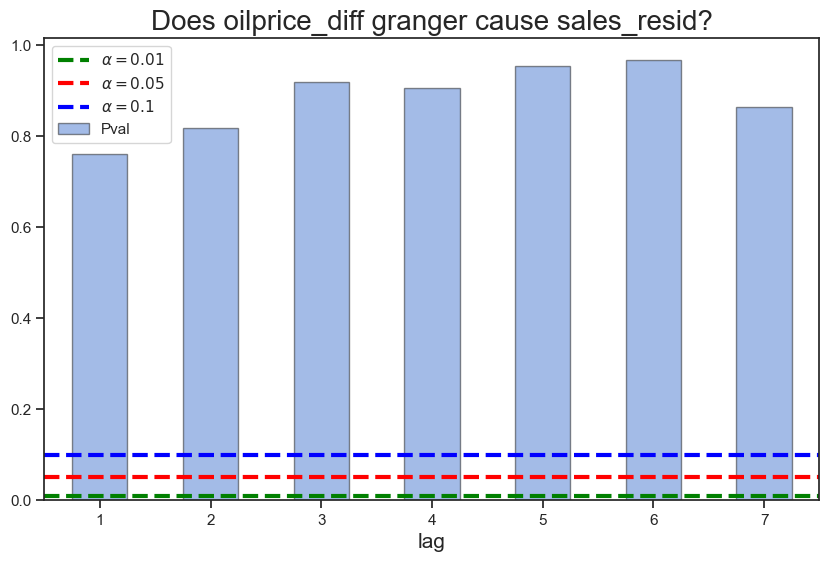

In [89]:
#Does oilprice_diff granger cause sales_resid?
granger_causality_test(x=agg_df[["sales_resid", "oilprice_diff"]], maxlag=7, alpha=0.01)

From the above results, the P-value for 7 previous lags are above 0.05, which means, oil prices do not have any effect on sales. Hence, we cannot reject the null hypothesis.


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=16.5955 , p=0.0000  , df_denom=1684, df_num=1
ssr based chi2 test:   chi2=16.6251 , p=0.0000  , df=1
likelihood ratio test: chi2=16.5437 , p=0.0000  , df=1
parameter F test:         F=16.5955 , p=0.0000  , df_denom=1684, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=3.9193  , p=0.0200  , df_denom=1681, df_num=2
ssr based chi2 test:   chi2=7.8618  , p=0.0196  , df=2
likelihood ratio test: chi2=7.8436  , p=0.0198  , df=2
parameter F test:         F=3.9193  , p=0.0200  , df_denom=1681, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=9.0476  , p=0.0000  , df_denom=1678, df_num=3
ssr based chi2 test:   chi2=27.2562 , p=0.0000  , df=3
likelihood ratio test: chi2=27.0381 , p=0.0000  , df=3
parameter F test:         F=9.0476  , p=0.0000  , df_denom=1678, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=15.2434 , p=0.

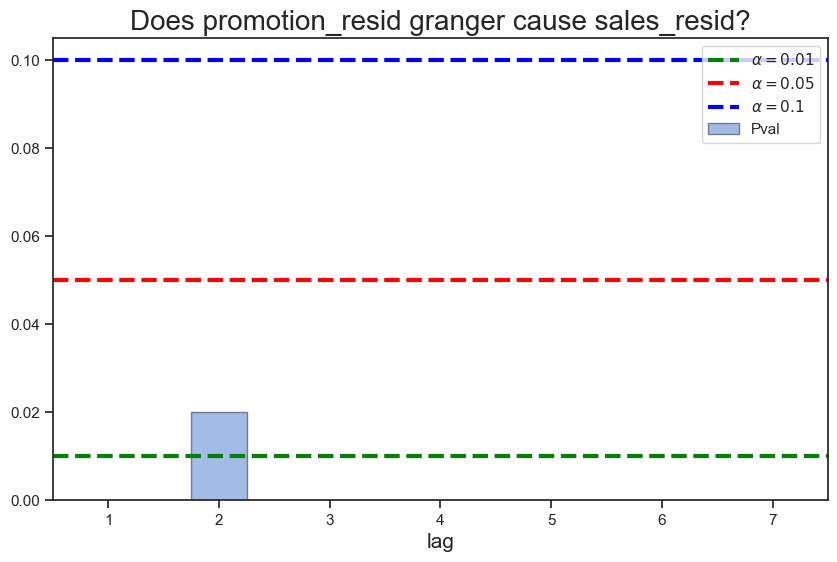

In [90]:
#Does promotion_resid granger cause sales_resid?
granger_causality_test(x=agg_df[["sales_resid", "promotion_resid"]], maxlag=7, alpha=0.01)

From the above result, P-value is lower than 0.05. Therefore, promotions do have some effect on sales.


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=1.8323  , p=0.1760  , df_denom=1683, df_num=1
ssr based chi2 test:   chi2=1.8356  , p=0.1755  , df=1
likelihood ratio test: chi2=1.8346  , p=0.1756  , df=1
parameter F test:         F=1.8323  , p=0.1760  , df_denom=1683, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.5608  , p=0.2103  , df_denom=1680, df_num=2
ssr based chi2 test:   chi2=3.1308  , p=0.2090  , df=2
likelihood ratio test: chi2=3.1279  , p=0.2093  , df=2
parameter F test:         F=1.5608  , p=0.2103  , df_denom=1680, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.9566  , p=0.4124  , df_denom=1677, df_num=3
ssr based chi2 test:   chi2=2.8818  , p=0.4102  , df=3
likelihood ratio test: chi2=2.8793  , p=0.4106  , df=3
parameter F test:         F=0.9566  , p=0.4124  , df_denom=1677, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=0.7579  , p=0.

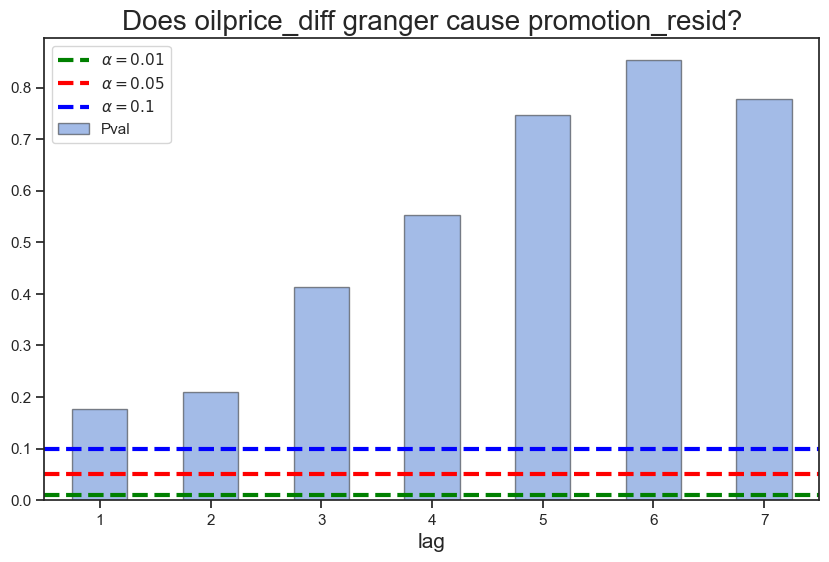

In [91]:
#Does oilprice_diff granger cause promotion_resid?
granger_causality_test(x=agg_df[["promotion_resid", "oilprice_diff"]], maxlag=7, alpha=0.01)

Similar to sales, oil prices have no effect on promotions.


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=6.2053  , p=0.0128  , df_denom=1684, df_num=1
ssr based chi2 test:   chi2=6.2164  , p=0.0127  , df=1
likelihood ratio test: chi2=6.2049  , p=0.0127  , df=1
parameter F test:         F=6.2053  , p=0.0128  , df_denom=1684, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=2.2026  , p=0.1108  , df_denom=1681, df_num=2
ssr based chi2 test:   chi2=4.4183  , p=0.1098  , df=2
likelihood ratio test: chi2=4.4126  , p=0.1101  , df=2
parameter F test:         F=2.2026  , p=0.1108  , df_denom=1681, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=15.9133 , p=0.0000  , df_denom=1678, df_num=3
ssr based chi2 test:   chi2=47.9392 , p=0.0000  , df=3
likelihood ratio test: chi2=47.2699 , p=0.0000  , df=3
parameter F test:         F=15.9133 , p=0.0000  , df_denom=1678, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=16.3899 , p=0.

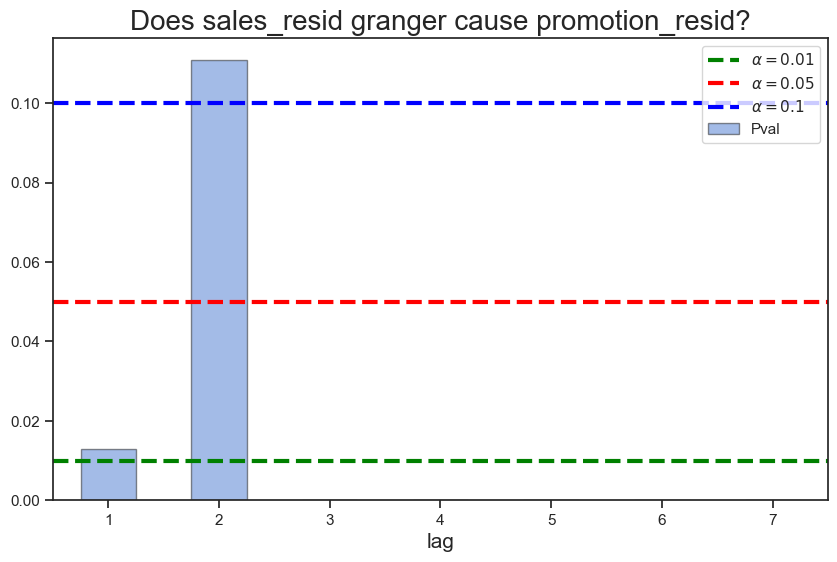

In [92]:
#Does sales_resid granger cause promotion_resid?
granger_causality_test(x=agg_df[["promotion_resid", "sales_resid"]], maxlag=7, alpha=0.01)

Interestingly, sales seems have an effect on promotions too on the first, followed by third lag and the following lags. This shows that both Sales and Promotions have a bidirectional relational. More details about [granger causality test](https://www.analyticsvidhya.com/blog/2021/08/granger-causality-in-time-series-explained-using-chicken-and-egg-problem/).

#### In conclusion, **oil prices is not a useful feature to forecast sales**. On the other hand, promotion feature is a potential useful feature to forecast sales.

# Lags

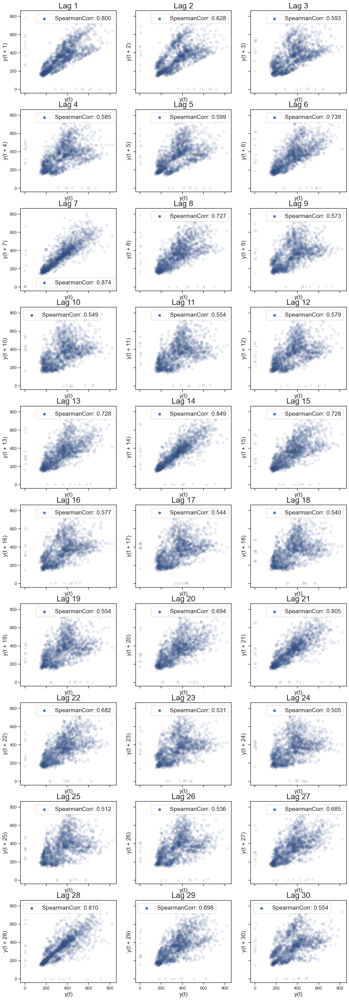

In [93]:
fig, axes = plt.subplots(10, 3, figsize=(15, 45), sharex=True, sharey=True)

for i, ax in zip(np.arange(1, 31, 1), axes.flatten()):
    
    temp_df = agg_df.copy()
    
    temp_df[f"sales_lag{i}"] = temp_df["sales"].shift(i)
    temp_df.dropna(inplace=True)
    
    cr = spearmanr(a=temp_df["sales"], b=temp_df[f"sales_lag{i}"])[0]
    
    pd.plotting.lag_plot(agg_df["sales"], lag = i, edgecolor="k", alpha = 0.1, c="b", ax=ax)
    ax.scatter(y=[], x=[], label=f"SpearmanCorr: {cr:.3f}")
    
    ax.legend(fontsize=15)
    ax.set_title(f"Lag {i}")

The above scatter plots depicts relation between sales and lagged sales. We can see the Spearman correlation between sales and lagged sales are stronger during the previous day lag and every 7th lag (sales before 7 days, before 14 days, before 21 days, before 28 days, etc).

In [94]:
for i in np.arange(7, 35, 7):
    agg_df[f"sales_lag{i}"] = agg_df["sales"].shift(periods=i)

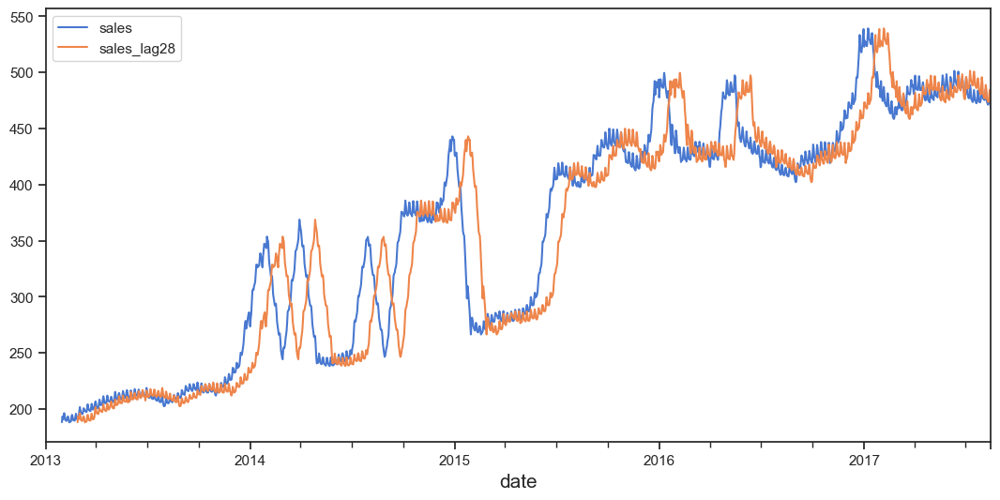

In [95]:
fig, ax = plt.subplots(figsize=(13, 6))

agg_df[["sales", "sales_lag28"]].rolling(30).mean().plot(ax=ax);

## ACF & PACF

Use Auto correlation and partial auto correlation plots, we will see how sales auto correlates with its own lags and different intervals of time.

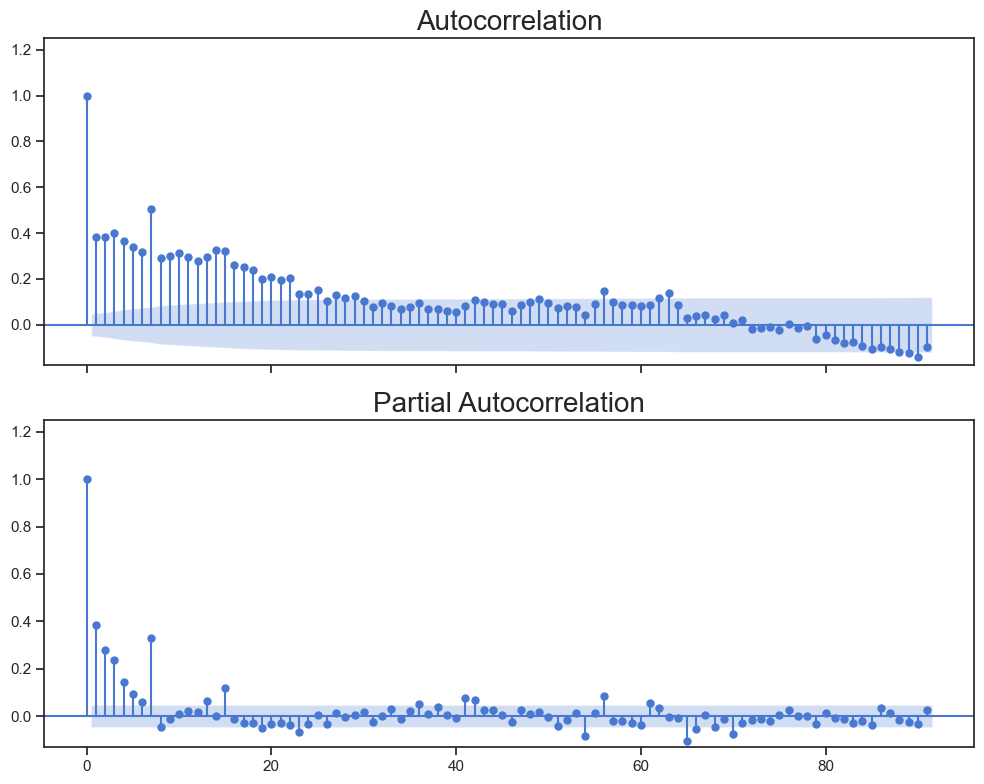

In [96]:
fig, ax = plt.subplots(2, 1, tight_layout=True, figsize=(10, 8), sharex=True)

plot_acf(x=agg_df["sales_resid"], lags=91, auto_ylims=True, ax=ax[0])
plot_pacf(x=agg_df["sales_resid"], lags=91, auto_ylims=True, ax=ax[1]);

From the above plots, sales seems to correlate well with the 1st lag, the 7th lag and the 14th lag. therefore, we will create new features to predict sales using these lags from sales.

## cross correlation function

As we have seen in the previous sections, promotions do influence sales. Here, we will check how lags of promotions affect sales.

In [97]:
def lag_plot(x, y, lag, ax=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=[5, 5])
    
    temp_df = pd.concat([y, x], axis=1)
    
    coly = temp_df.columns[0]
    colx = temp_df.columns[1]
    
    temp_df[f"x_lag{lag}"] = temp_df[colx].shift(periods=lag)
    temp_df.dropna(inplace=True)
    
    cr = spearmanr(a=temp_df[coly], b=temp_df[f"x_lag{lag}"])[0]
    
    sns.regplot(y=coly, x=f"x_lag{lag}", data=temp_df, color="b", ax=ax, scatter_kws={'alpha':0.2, 'color':'b', 'edgecolor':'k'}, line_kws={'color':'r'})
    ax.scatter(y=[], x=[], label=f"SpearmanCorr: {cr:.3f}")
    
    ax.set_ylabel("$y_t$")
    ax.set_xlabel(f"$x_{{t-{lag}}}$")
    
    leg=ax.legend(fontsize=15, markerscale=0, frameon=False)
    
    return ax

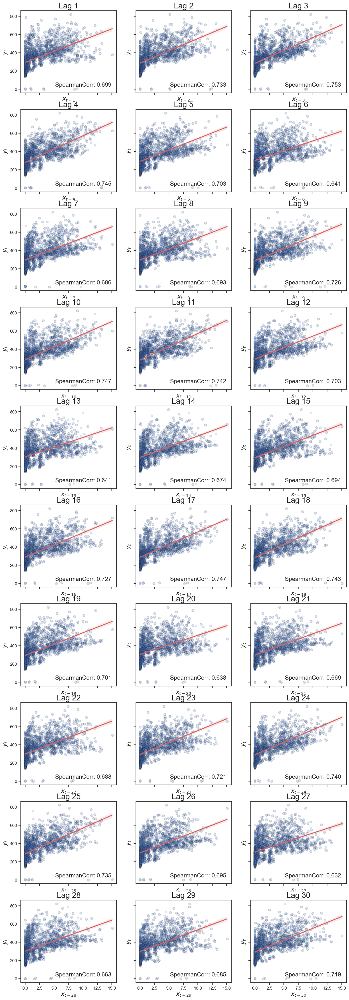

In [98]:
# Plot a lag plot
fig, ax = plt.subplots(10, 3, figsize=[15, 45], sharex=True, sharey=True, )

axs = ax.flatten()

for ix, lag in enumerate(range(1, 31, 1)):
    
    ax = lag_plot(y=agg_df["sales"], x=agg_df["onpromotion"], lag=lag, ax=axs[ix])
    
    ax.set_title(f"Lag {lag}")

The above scatter plots depicts relation between sales and lags of promotions. It is not immediately clear how strong the correlations are between lags of promotions and sales. We will use cross correlation function to see how lags of promotion affect sales.

In [99]:
def plot_ccf(x, y, lags):
    
    # Compute CCF and confidence interval
    cross_corrs = ccf(x, y)
    ci = 2 / np.sqrt(len(y))
    
    # Create plot
    fig, ax = plt.subplots(figsize=[10, 5])
    
    ax.stem(range(0, lags + 1), cross_corrs[: lags + 1])
    ax.fill_between(range(0, lags + 1), ci, y2=-ci, alpha=0.2)
    ax.set_title("Cross-correlation")
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    
    return ax

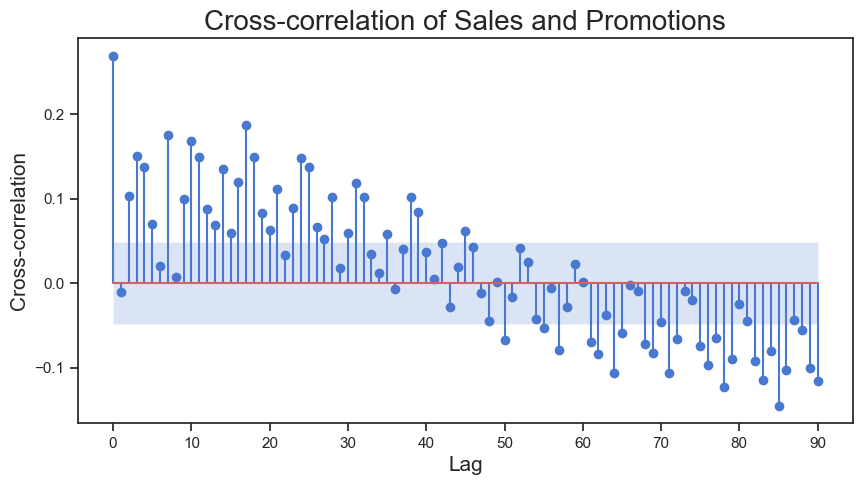

In [100]:
ax = plot_ccf(y=agg_df["sales_resid"], x=agg_df["promotion_resid"], lags=90)
ax.set_title("Cross-correlation of Sales and Promotions")
ax.set_ylabel("Cross-correlation")
ax.set_xlabel("Lag");

From the above cross-correlation function plot, it seems promotion lags of 3, 4 and 7 have a stronger correlation with sales. Therefore, we will consider using these promotion lags as features

In [101]:
for i in [3, 4, 7]:
    agg_df[f"promot_lag{i}"] = agg_df["onpromotion"].shift(i)

In [102]:
agg_df.columns

Index(['sales', 'onpromotion', 'dcoilwtico', 'sales_resid', 'promotion_resid',
       'oilprice_diff', 'sales_lag7', 'sales_lag14', 'sales_lag21',
       'sales_lag28', 'promot_lag3', 'promot_lag4', 'promot_lag7'],
      dtype='object')

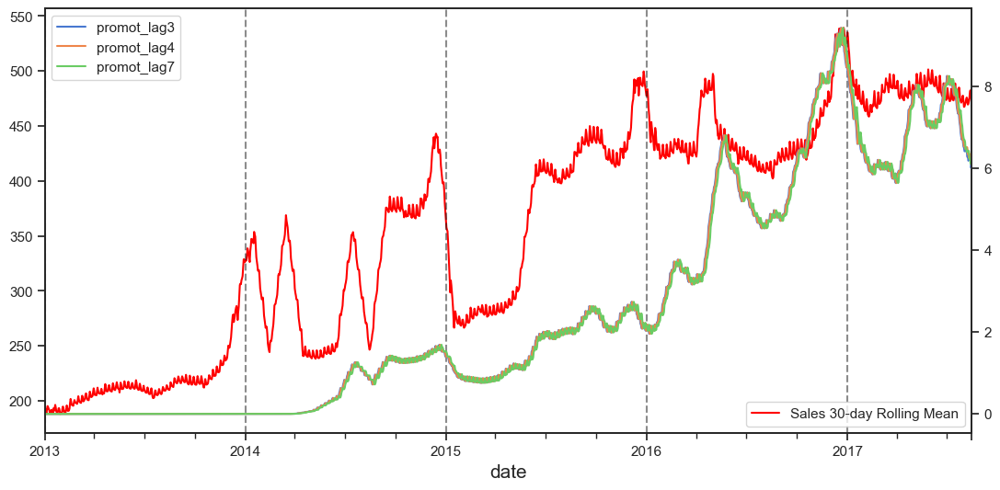

In [103]:
fig, ax1 = plt.subplots(figsize=(13, 6))

ax2 = ax1.twinx()

agg_df["sales"].rolling(30, center=True, min_periods=7).mean().plot(ax=ax1, c='red')

agg_df[['promot_lag3', 'promot_lag4', 'promot_lag7']].\
    rolling(30, center=True, min_periods=7).mean().plot(ax=ax2);

ax1.legend(labels=[f"Sales 30-day Rolling Mean"], loc="lower right")

for newyear in pd.date_range("2013-01-01", "2017-01-01", freq="YS"):
    ax1.axvline(newyear, color="k", alpha=0.5, ls="--")

The above plot compares 30 day rolling promotion lag plots and 30 day rolling sales plot. We can see during some periods of time intervals, both promotions and sales move in unison.

# Feature Engineering

In [104]:
#Create lags and then fill null values with 0.
#Sales lags
for lag in [1, 7, 14]:
    train_df[f'sales_lag{lag}']=train_df.groupby(['store_nbr', 'family'])['sales'].shift(lag).fillna(0)

#Promotions lag
for lag in [3, 4, 7]:
    train_df[f'onpromotion_lag{lag}']=train_df.groupby(['store_nbr', 'family'])['onpromotion'].\
                                          shift(lag).fillna(0)

In [105]:
#creating a dictionary that contains dates of each holidays.
#In the next section, we will create binary columns for each holidays.
holiday_event_dict = {
    "is_christmas" : christmas,
    "is_xmas_hol_extra" : xmas_hol_extra,
    "is_new_year" : new_year,
    "is_transferred" : transfer_dates,
    "is_other_nat_holidays" : national_holidays_2,
    "is_reg_holidays" : reg_holidays,
    "is_local_holidays" : local_holidays,
    "is_earthquake" : earthquake,
    "is_cybermonday" : cyb_mon,
    "is_blackfriday" : blk_fri,
    "is_momsday" : moms_day,
    "is_football" : futbol
}

In [106]:
reg_hol_state = set(holiday_df.query("locale=='Regional'")['locale_name'])
loc_hol_city = set(holiday_df.query("locale=='Local'")['locale_name'])

In [107]:
#For example, if christmass, then 1, else 0.
for key, val in holiday_event_dict.items():
    
    #Assigning 1 to only those states that celebrates respective regional holidays
    if key=="is_reg_holidays":
        train_df.loc[train_df['date'].isin(val) & train_df['state'].isin(reg_hol_state), key] = 1
        train_df[key] = train_df[key].fillna(0)
    
    #Assigning 1 to only those city that celebrates respective local holidays
    elif key=="is_local_holidays":
        train_df.loc[train_df['date'].isin(val) & train_df['city'].isin(loc_hol_city), key] = 1
        train_df[key] = train_df[key].fillna(0)
    
#     #Assigning 1 to only Manabi state where the earthquake took place
#     elif key=="is_earthquake":
#         train_df.loc[train_df['date'].isin(val) & train_df['state'].eq('Manabi'), key] = 1
#         train_df[key] = train_df[key].fillna(0)
    
    else:
        train_df.loc[train_df['date'].isin(val), key] = 1
        train_df[key] = train_df[key].fillna(0)

In [108]:
#Dropping these columns
train_df = train_df.drop(['cluster', 'is_promotion', 'is_weekend', 'type'], axis=1)

In [109]:
#Here, we will take the expanding mean of sales for each products from each stores.

#First groupby Store and product, then take expanding mean of sales.
#Second, again group by store and product in order to shift down at product level for each store.
#Backfill to fill null values
#Finally, sort by level_2 which contains old index. This ensures the data is same order as
#original train set where data is sorted by date, store and then product.

train_df['prd_sales_enc']=\
train_df.groupby(['store_nbr', 'family'], as_index=False)['sales'].expanding().mean().\
    groupby(['store_nbr', 'family']).shift().bfill().reset_index().\
        sort_values(["level_2", "store_nbr", "family"], ignore_index=True)['sales']

In [110]:
#Here we will create window features for each prd from each store.
#We will choose windows of 7 days, 30 days nd 364 days and then take the mean and median.

agg_list = ["mean", "median"]

train_df[["sales_window_7_" + col for col in agg_list]]=\
train_df.groupby(['store_nbr', 'family'], as_index=False)['sales'].\
    rolling(window=7, min_periods=1).agg(agg_list).\
        groupby(['store_nbr', 'family']).shift().bfill().reset_index().\
            sort_values(["level_2", "store_nbr", "family"], ignore_index=True)[agg_list]

In [111]:
train_df.head()

,store_nbr,family,date,sales,onpromotion,day,month,year,day_of_week,city,...,is_reg_holidays,is_local_holidays,is_earthquake,is_cybermonday,is_blackfriday,is_momsday,is_football,prd_sales_enc,sales_window_7_mean,sales_window_7_median
0,1,AUTOMOTIVE,2013-01-01,0.000000,0,1,1,2013,1,Quito,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1,BABY CARE,2013-01-01,0.000000,0,1,1,2013,1,Quito,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,1,BEAUTY,2013-01-01,0.000000,0,1,1,2013,1,Quito,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,1,BEVERAGES,2013-01-01,0.000000,0,1,1,2013,1,Quito,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,1,BOOKS,2013-01-01,0.000000,0,1,1,2013,1,Quito,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


# Train-Test split & Prediction

In [112]:
train_df_copy = train_df.dropna()

#Data before this date will be considered train. Dates from this date will be test. 
#Test set contains data for the next 30 days (from "2017-07-15" to "2017-08-15")
cut_off_date = "2017-07-15"

X_train = train_df_copy.loc[train_df_copy['date'].lt(cut_off_date)].drop(['date', 'sales'], axis=1)
y_train = train_df_copy.loc[train_df_copy['date'].lt(cut_off_date), 'sales']

X_test = train_df_copy.loc[train_df_copy['date'].ge(cut_off_date)].drop(['date', 'sales'], axis=1)
y_test = train_df_copy.loc[train_df_copy['date'].ge(cut_off_date), 'sales']

In [113]:
#Creating pipeline
cat_variables=['family', 'city', 'state']
time_variables = ['day', 'month', 'day_of_week']

#Encode categorical columns with numbers.
ord_encoder=OrdinalEncoder(encoding_method='arbitrary', variables=cat_variables)

#Convert time features such as day, month and day of week to cyclical features to maintain cyclicity.
cf_encoder = CyclicalFeatures(variables=time_variables)

#Creating encoder pipeline
encoders = make_pipeline(
    (ord_encoder), #Ordinal Encoder
    (cf_encoder), #Cyclical Feature
)

In [114]:
#We will use the XGBoost regressor to predict sales for each products from each stores.
#In total, we will need to predict individual daily sales of 1782 products for the next 30 days.
#33 Products from 54 stores = 1782 total products

#XGBoost
xgb=XGBRegressor(
    n_estimators=100,
    max_depth=6,
    eta=0.3,
    gamma=0,
    n_jobs=-1, 
    random_state=seed,
    eval_metric="rmse"
)

In [115]:
#Putting whole pipeline together
pipeline = make_pipeline(
    (encoders), #Encoders
    (xgb) #XGBoost
)

print("Pipeline Created!")

Pipeline Created!


In [116]:
%%time

#Here we will train the model using 5-fold Time series cross validation. RMSE metric will be used.

tscv = TimeSeriesSplit(n_splits=5, gap=7*54*33)

rmse_values = []

cv = 1
# Loop through the folds
print("Cross Validating.....")
print()

for train_index, test_index in tscv.split(X_train, y_train):
       
    X_train_cv, X_test_cv = X_train.iloc[train_index], X_train.iloc[test_index]
    y_train_cv, y_test_cv = y_train.iloc[train_index], y_train.iloc[test_index]

    # Fit the model on the train data
    pipeline.fit(X_train_cv, y_train_cv)

    # Predict on the test data
    y_pred = pipeline.predict(X_test_cv)
    
    # Calculate the mean squared error
    rmse = mean_squared_error(y_test_cv, y_pred, squared=False)
        
    print(f"cv #{cv}: RMSE = {rmse:.3f}")
    
    rmse_values.append(rmse)
    cv += 1

# Print the average MSE over all folds
print()
print(f"Average RMSE: {np.mean(rmse_values):.3f}")

Cross Validating.....

cv #1: RMSE = 268.303
cv #2: RMSE = 241.690
cv #3: RMSE = 265.314
cv #4: RMSE = 386.066
cv #5: RMSE = 311.328

Average RMSE: 294.540
Wall time: 15min 51s


In [117]:
feat_scores=pipeline.steps[-1][-1].feature_importances_

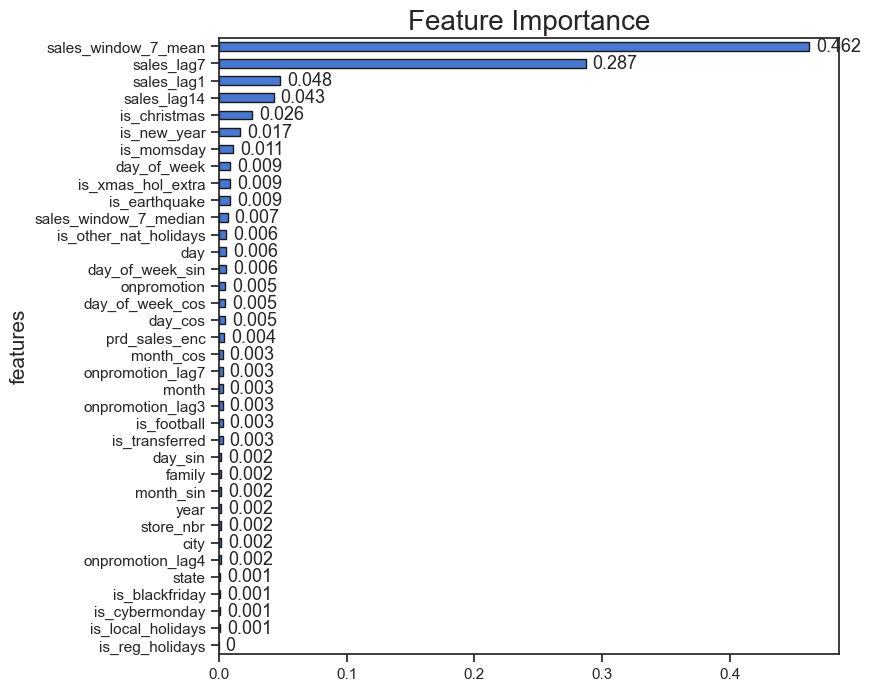

In [118]:
feat_imp_df = \
pd.DataFrame({
    'features' :encoders.fit_transform(X_train).columns,
    'importance' : np.round(feat_scores, 3)
}).set_index('features').sort_values('importance')


ax = feat_imp_df.plot(kind='barh', edgecolor='k', figsize=(8, 8))

ax.bar_label(ax.containers[0], fontsize = 13, padding = 5);
ax.legend().remove()
ax.set_title("Feature Importance");

From the above feature importance plot, the most important features according to XGboost are the lags of sales, holiday variables such as Christmas, and certain time features such as day of week.

In [119]:
predictions = pipeline.predict(X_test)

test_rmse = mean_squared_error(y_test, predictions, squared=False)

print(f"Test RMSE Score: {test_rmse:.3f}")

Test RMSE Score: 213.661


The Test RMSE is significantly lower than the train score.

In [120]:
test_df = pd.concat([X_test[['store_nbr', 'family']], y_test], axis=1)
test_df['predictions'] = predictions
test_df['date'] = train_df_copy.loc[train_df_copy['date'].ge(cut_off_date), 'date']

In [121]:
agg_test_df=\
test_df.groupby(['date', 'family'], as_index=False)[['sales', 'predictions']].sum()

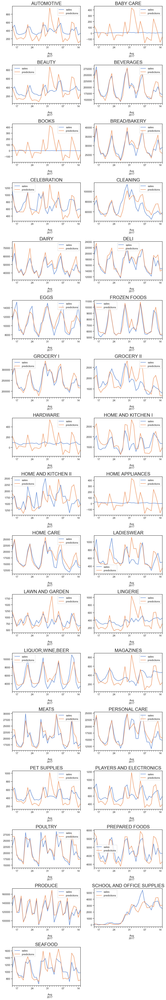

In [122]:
fig, axes = plt.subplots(17, 2, tight_layout=True, figsize=(10, 60), squeeze = False)

for prd, ax in zip(agg_test_df['family'].unique(), axes.flatten()):
    
    agg_test_df.query(f"family=='{prd}'").plot(x='date', y=['sales', 'predictions'], ax=ax)
    ax.set_title(prd)
    
    ax.set_xlabel("");
    
axes[-1,-1].set_axis_off()

The above plots compares actual sales of test set and predicted sales. What's obvious are:

* the model does a good job at predicting sales for those products with very high sales. These products are PRODUCE, GROCERY I, DAIRY, BREAD/BAKERY, DELI, BEVERAGES, etc.


* The model performs poorly for those predicts with sporadic and very low sales, such as HARDWARE, HOME APPLIANCES, BABY CARE, BOOKS, etc.

Perhaps with techniques such as feature selection to select only those features with the best performance and tuning the parameters of the model could further improve the model performance. 

Since the dataset is very big, it is computationally expensive to do the above methods. So, for now I am skipping these.

In [123]:
pd.options.display.float_format = '{:,.4f}'.format

def get_rmse(x):
    return mean_squared_error(x['sales'], x['predictions'], squared=False)

family_aggs = \
test_df.groupby('family').apply(
    lambda x: pd.Series({'mean_sales' : x['sales'].mean(), 'rmse_score' : get_rmse(x)})
)

family_aggs['pct_error'] = family_aggs['rmse_score']/family_aggs['mean_sales']

family_aggs.sort_values('pct_error')

,mean_sales,rmse_score,pct_error
family,,,
GROCERY I,"4,597.5661",686.2639,0.1493
PRODUCE,"2,315.2913",356.0485,0.1538
BREAD/BAKERY,540.3954,96.0251,0.1777
DAIRY,853.4294,160.5346,0.1881
DELI,308.2491,58.9653,0.1913
BEVERAGES,"3,613.9167",764.3756,0.2115
HOME CARE,312.4144,76.0223,0.2433
MEATS,374.4442,91.9730,0.2456
PREPARED FOODS,88.6281,21.9856,0.2481


The above table shows the aggregated mean sales of all products of all stores. We can see how far the RMSE score is for each products. In order to understand how high the error is, the RMSE score for each product is divided by the mean sales. This way, its easier to compare how big the error is across all products.


As mentioned earlier, the model predicts better for those products with higher daily sales and the rror of prediction is very low. The model performs the worst for BOOKS, BABY CARE, HOME APPLIANCES, etc.

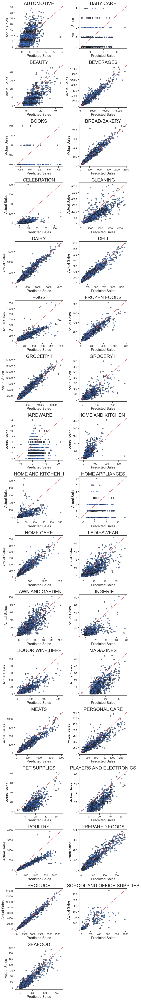

In [124]:
fig, axes = plt.subplots(17, 2, tight_layout=True, figsize=(8, 60), squeeze = False)

for prd, ax in zip(agg_test_df['family'].unique(), axes.flatten()):

    test_df.query(f"family=='{prd}'").\
            plot(x='predictions', y='sales', kind='scatter', edgecolor='k', color='b', ax=ax, alpha=0.7)

    ax.plot([0, 1], [0, 1], transform=ax.transAxes, color='r', ls='--')
    
    ax.set_ylabel("Actual Sales")
    ax.set_xlabel("Predicted Sales")
    
    ax.set_title(prd);
    
axes[-1,-1].set_axis_off();

The above scatter plots how close the predictions are with the actual sales. The closer the data points are to the diagonal line, the accurate the predictions are. As observed earlier, model performs poorly on those products with periodic and low sales. Conversely, the model performs well for those products where there is significant daily sales.